In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA

file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)
print(time_series_data)

                                                Topic  January  February  \
0                         BNP's speech about election      158         0   
1   Awami league's meeting or briefing about elect...      125         0   
2         Election polling by awami league candidates       61         0   
3            Police case filing against bnp's leaders       31        38   
4             Election monitor by foreign observers\t       21         4   
5   Parliament setup after election for awami leag...       18         0   
6           Some awami league leaders out of election        7         0   
7                                Bnp leader's meeting        1        91   
8                                        Jatiya party        0        10   
9                                   Pakistan Campaign        0         9   
10                            Khaleda zia in hospital        0         7   
11                    Refugee detention in Bangladesh        0         1   
12          

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltk.tokenize import word_tokenize
from nltk.stem.snowball import SnowballStemmer
from nltk.corpus import stopwords
import string
import numpy as np

In [ ]:
datascience_df = pd.read_csv("sample_data/dataset_overall.csv",parse_dates=True)
datascience_df = datascience_df.dropna()
import re
def simple_clean_text(x):
    x = x.lower()
    x = re.sub('[^a-z]'," ",x)
    x = re.sub(' +',' ',x).strip()
    words = x.split()
    return " ".join(words)
datascience_df['description'] = datascience_df['description'].apply(lambda x: simple_clean_text(x))
import nltk
nltk.download('stopwords')
stop = stopwords.words('english')
stop.extend(['trump','donald','kamala','harris','joe','biden','melania','ivanka'])
datascience_df['date'] = pd.to_datetime(datascience_df['date'])
datascience_df['description_without_stopwords'] = datascience_df['description'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))
docs = datascience_df['description_without_stopwords']
month_groups = {month: df_group for month, df_group in datascience_df.groupby(datascience_df['date'].dt.strftime('%Y-%m'))}
df = []
# Save each month's dataset or view it
for month, data in month_groups.items():
    #print(f"\nData for {month}:\n")
    df.append(data)
#print(df[0])
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import numpy as np

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
no_features =1000 #max number of words to be consider in the analysis
no_topics = 10 #number of topics to consider
no_top_words = 10 #number of topics to display for each topic
tf_vectorizer = CountVectorizer(max_df=0.95, min_df=2, max_features=no_features,stop_words="english")
#after defining the vectorizer we will fit it on the data that we have cleaned
#tf = tf_vectorizer.fit_transform(datascience_df['description_without_stopwords'])
tf = tf_vectorizer.fit_transform(df[7]['description_without_stopwords'])
tf_feature_names = tf_vectorizer.get_feature_names_out()
lda = LatentDirichletAllocation(n_components=no_topics,max_iter=20,learning_method='online',learning_offset=50,random_state=0).fit(tf)
lda
def display_topics(model, feature_names, no_top_words):
    topics = {}
    for topic_idx, topic in enumerate(model.components_):
        topics[f"Topic {topic_idx}"] = " ".join([feature_names[i] for i in topic.argsort()[:-no_top_words -1:-1]])
    return topics
topics = display_topics(lda,tf_feature_names,no_top_words)
topics

{'Topic 0': 'league said awami august minister hasina dhaka sheikh case party',
 'Topic 1': 'said president campaign democratic presidential national republican convention union workers',
 'Topic 2': 'said government bnp people interim bangladesh party country chief fakhrul',
 'Topic 3': 'comments election facebook network posted posts political accounts profile cent',
 'Topic 4': 'case court august people police procession july league leaders awami',
 'Topic 5': 'army local area robbery league uttara people awami mirpur entered',
 'Topic 6': 'india reported hasina asylum delhi indian sheikh joy news family',
 'Topic 7': 'jamaat islami government shibir ban bangladesh chhatra party banned said',
 'Topic 8': 'dal chhatra kennedy court tarique justice high said rahman rangpur',
 'Topic 9': 'case filed police accused hasina minister sheikh general khan complaint'}

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Display word clouds for topics 0 to 4
for topic_idx in range(20):
    topic_key = f"Topic {topic_idx}"
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(topics[topic_key])

    # Plot the word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"Word Cloud for {topic_key}")
    plt.show()

In [ ]:
from wordcloud import WordCloud
print(topics)
# def create_wordcloud(topic):
#     text = {word: value for word, value in topics[f"Topic {topic}"]}
#     wc = WordCloud(background_color="white", max_words=1000)
#     wc.generate_from_frequencies(text)
#     plt.imshow(wc, interpolation="bilinear")
#     plt.axis("off")
#     plt.show()
# for i in range(20):
#   create_wordcloud(i)

In [ ]:
topics_label_january= {
    0:"bnp leader's meeting",
    1:"awami league's briefing about election",
    2:"Police case filing against bnp's leaders",
    3:"some awami league leaders out of election",
    4:"BNP not attending in election",
    5:"Parliament setup after election for awami league",
    6:"Anti-sided government formation",
    7:"Election monitor by foreign observers",
    8:"BNP'speech about election",
    9:"Election polling by awami league candidates",
}
topics_label_january.values()
topic_assignments = lda.transform(tf)
df[0]['dominant_topic']=topic_assignments.argmax(axis=1)
df[0].info()
df[0]['topic_labels']=df[0]['dominant_topic'].apply(lambda x :topics_label_january.get(x,"Unknown"))
df[0]['dominant_topic'].value_counts()
df[0]['topic_labels'].value_counts()

<class 'pandas.core.frame.DataFrame'>
Index: 422 entries, 383 to 2101
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   title                          422 non-null    object        
 1   link                           422 non-null    object        
 2   date                           422 non-null    datetime64[ns]
 3   description                    422 non-null    object        
 4   summary                        422 non-null    object        
 5   description_without_stopwords  422 non-null    object        
 6   dominant_topic                 422 non-null    int64         
 7   topic_labels                   422 non-null    object        
dtypes: datetime64[ns](1), int64(1), object(6)
memory usage: 29.7+ KB


,count
topic_labels,
BNP's apeech about election,158
awami league's briefing about election,125
Election polling by awami league candidates,61
Police case filing against bnp's leaders,31
Election monitor by foreign observers,21
Parliament setup after election for awami league,18
some awami league leaders out of election,7
bnp leader's meeting,1


In [ ]:
topics_label_february= {
    0:"bnp leader's meeting",
    1:"Election monitor by foreign observers",
    2:"Police case filing against bnp's leaders",
    3:"Khaleda zia in hospital",
    4:"Court file against cumilla mayor",
    5:"Pakistan campaign",
    6:"Refugee detention in Bangladesh",
    7:"BNP's one leader elected in election",
    8:"Jatiya party",
    9:"Comilla city Election",

}
topics_label_january.values()
topic_assignments = lda.transform(tf)
df[1]['dominant_topic']=topic_assignments.argmax(axis=1)
df[1].info()
df[1]['topic_labels']=df[1]['dominant_topic'].apply(lambda x :topics_label_february.get(x,"Unknown"))
df[1]['dominant_topic'].value_counts()
df[1]['topic_labels'].value_counts()

<class 'pandas.core.frame.DataFrame'>
Index: 160 entries, 341 to 1976
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   title                          160 non-null    object        
 1   link                           160 non-null    object        
 2   date                           160 non-null    datetime64[ns]
 3   description                    160 non-null    object        
 4   summary                        160 non-null    object        
 5   description_without_stopwords  160 non-null    object        
 6   dominant_topic                 160 non-null    int64         
dtypes: datetime64[ns](1), int64(1), object(5)
memory usage: 10.0+ KB


,count
topic_labels,
bnp leader's meeting,91
Police case filing against bnp's leaders,38
Jatiya party,10
Pakistan campaign,9
Khaleda zia in hospital,7
Election monitor by foreign observers,4
Refugee detention in Bangladesh,1


In [ ]:
topics_label_march= {
    0:"Jatiya Party",
    1:"Comilla city election",
    2:"Khaleda zia in hospita",
    3:"BNP boycott election",
    4:"Police case filing against bnp's leaders",
    5:"Awami league's selection",
    6:"BNP Rally",
    7:"BNP's denial of election and govt. formation",
    8:"Awami league",
    9:"BNP leaders condolation on injured people",

}
topics_label_january.values()
topic_assignments = lda.transform(tf)
df[2]['dominant_topic']=topic_assignments.argmax(axis=1)
df[2].info()
df[2]['topic_labels']=df[2]['dominant_topic'].apply(lambda x :topics_label_march.get(x,"Unknown"))
df[2]['dominant_topic'].value_counts()
df[2]['topic_labels'].value_counts()

<class 'pandas.core.frame.DataFrame'>
Index: 156 entries, 291 to 1931
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   title                          156 non-null    object        
 1   link                           156 non-null    object        
 2   date                           156 non-null    datetime64[ns]
 3   description                    156 non-null    object        
 4   summary                        156 non-null    object        
 5   description_without_stopwords  156 non-null    object        
 6   dominant_topic                 156 non-null    int64         
 7   topic_labels                   0 non-null      object        
dtypes: datetime64[ns](1), int64(1), object(6)
memory usage: 11.0+ KB


,count
topic_labels,
Awami league,44
BNP's denial of election and govt. formation,32
Khaleda zia in hospita,32
Jatiya Party,20
BNP boycott election,16
BNP leaders condolation on injured people,8
Police case filing against bnp's leaders,2
BNP Rally,1
Comilla city election,1


In [ ]:
topics_label_april= {
    0:"India's Election",
    1:"Upazilla election in BD",
    2:"Awami leagues press briefing",
    3:"Market Briefing",
    4:"Student politics",
    5:"Police case filing against bnp leaders",
    6:"BNP meeting regarding election",
    7:"BNP's denial of govt. formation",
    8:"Awami league",
    9:"Khaleda zia's treatment",

}
topics_label_january.values()
topic_assignments = lda.transform(tf)
df[3]['dominant_topic']=topic_assignments.argmax(axis=1)
df[3].info()
df[3]['topic_labels']=df[3]['dominant_topic'].apply(lambda x :topics_label_april.get(x,"Unknown"))
df[3]['dominant_topic'].value_counts()
df[3]['topic_labels'].value_counts()

<class 'pandas.core.frame.DataFrame'>
Index: 136 entries, 243 to 1880
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   title                          136 non-null    object        
 1   link                           136 non-null    object        
 2   date                           136 non-null    datetime64[ns]
 3   description                    136 non-null    object        
 4   summary                        136 non-null    object        
 5   description_without_stopwords  136 non-null    object        
 6   dominant_topic                 136 non-null    int64         
dtypes: datetime64[ns](1), int64(1), object(5)
memory usage: 8.5+ KB


,count
topic_labels,
Awami leagues press briefing,46
BNP's denial of govt. formation,45
Police case filing against bnp leaders,17
Awami league,15
Khaleda zia's treatment,9
Student politics,4


In [ ]:
topics_label_june= {
    0:"upazilla election maintain",
    1:"upazila election",
    2:"Annual Budget and inflation",
    3:"BNP leader's meeting",
    4:"Awami league leader's murder",
    5:"BNP's speech about election",
    6:"Awami league's meeting",
    7:"Election monitor by foreign observers(Upazila)",
    8:"BNP'speech about election",
    9:"Police case against bnp leaders",
}
topics_label_june.values()
topic_assignments = lda.transform(tf)
df[5]['dominant_topic']=topic_assignments.argmax(axis=1)
df[5].info()
df[5]['topic_labels']=df[5]['dominant_topic'].apply(lambda x :topics_label_june.get(x,"Unknown"))
df[5]['dominant_topic'].value_counts()
df[5]['topic_labels'].value_counts()

<class 'pandas.core.frame.DataFrame'>
Index: 162 entries, 122 to 1772
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   title                          162 non-null    object        
 1   link                           162 non-null    object        
 2   date                           162 non-null    datetime64[ns]
 3   description                    162 non-null    object        
 4   summary                        162 non-null    object        
 5   description_without_stopwords  162 non-null    object        
 6   dominant_topic                 162 non-null    int64         
dtypes: datetime64[ns](1), int64(1), object(5)
memory usage: 10.1+ KB


,count
topic_labels,
BNP leader's meeting,77
Awami league's meeting,27
Annual Budget and inflation,27
Election monitor by foreign observers(Upazila),20
Awami league leader's murder,6
BNP's speech about election,3
Police case against bnp leaders,1
upazilla election maintain,1


In [ ]:
topics_label_may= {
    0:"BNP leaders meeting",
    1:"upazilla election",
    2:"khaleda zia in hospital",
    3:"israel palestine war",
    4:"Observe election by foreign observers",
    5:"Awami league leaders meeting",
    6:"Police case filing against BNP leaders",
    7:"Labor movement",
    8:"Awami league leader's death",
    9:"Corruption of army officers",
}
topics_label_may.values()
topic_assignments = lda.transform(tf)
df[4]['dominant_topic']=topic_assignments.argmax(axis=1)
df[4].info()
df[4]['topic_labels']=df[4]['dominant_topic'].apply(lambda x :topics_label_may.get(x,"Unknown"))
df[4]['dominant_topic'].value_counts()
df[4]['topic_labels'].value_counts()

<class 'pandas.core.frame.DataFrame'>
Index: 263 entries, 176 to 2272
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   title                          263 non-null    object        
 1   link                           263 non-null    object        
 2   date                           263 non-null    datetime64[ns]
 3   description                    263 non-null    object        
 4   summary                        263 non-null    object        
 5   description_without_stopwords  263 non-null    object        
 6   dominant_topic                 263 non-null    int64         
dtypes: datetime64[ns](1), int64(1), object(5)
memory usage: 16.4+ KB


,count
topic_labels,
BNP leaders meeting,133
upazilla election,53
Police case filing against BNP leaders,26
Labor movement,13
Awami league leaders meeting,12
khaleda zia in hospital,12
Awami league leader's death,6
Corruption of army officers,4
Observe election by foreign observers,3


In [ ]:
topics_label_july= {
    0:"BNP leaders meeting",
    1:"israel palestine war",
    2:"jamaat e islami shibir",
    3:"Quota movement",
    4:"BNP rally",
    5:"khaleda zia in hospital",
    6:"Student politics",
    7:"Labor movement",
    8:"Police case file against bnp leaders",
    9:"Awami league leaders meeting",
}
topics_label_july.values()
topic_assignments = lda.transform(tf)
df[6]['dominant_topic']=topic_assignments.argmax(axis=1)
df[6].info()
df[6]['topic_labels']=df[6]['dominant_topic'].apply(lambda x :topics_label_july.get(x,"Unknown"))
df[6]['dominant_topic'].value_counts()
df[6]['topic_labels'].value_counts()

<class 'pandas.core.frame.DataFrame'>
Index: 162 entries, 89 to 2172
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   title                          162 non-null    object        
 1   link                           162 non-null    object        
 2   date                           162 non-null    datetime64[ns]
 3   description                    162 non-null    object        
 4   summary                        162 non-null    object        
 5   description_without_stopwords  162 non-null    object        
 6   dominant_topic                 162 non-null    int64         
 7   topic_labels                   162 non-null    object        
dtypes: datetime64[ns](1), int64(1), object(6)
memory usage: 11.4+ KB


,count
topic_labels,
BNP rally,54
Awami league leaders meeting,29
BNP leaders meeting,28
Labor movement,16
jamaat e islami shibir,13
Quota movement,7
khaleda zia in hospital,7
Student politics,5
Police case file against bnp leaders,3


In [ ]:
topics_label_august= {
    0:"BNP leaders meeting",
    1:"police file case against leaders",
    2:"yunus as cheif advisor",
    3:"BNP rally",
    4:"jamaat ban from politics",
    5:"Quota movement",
    6:"Upazila election",
    7:"Awami leagues meeting",
    8:"confusing",
    9:"Police activities against activist",
}
topics_label_august.values()
topic_assignments = lda.transform(tf)
df[7]['dominant_topic']=topic_assignments.argmax(axis=1)
df[7].info()
df[7]['topic_labels']=df[7]['dominant_topic'].apply(lambda x :topics_label_august.get(x,"Unknown"))
df[7]['dominant_topic'].value_counts()
df[7]['topic_labels'].value_counts()

<class 'pandas.core.frame.DataFrame'>
Index: 302 entries, 52 to 2140
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   title                          302 non-null    object        
 1   link                           302 non-null    object        
 2   date                           302 non-null    datetime64[ns]
 3   description                    302 non-null    object        
 4   summary                        302 non-null    object        
 5   description_without_stopwords  302 non-null    object        
 6   dominant_topic                 302 non-null    int64         
dtypes: datetime64[ns](1), int64(1), object(5)
memory usage: 18.9+ KB


,count
topic_labels,
Awami leagues meeting,105
BNP leaders meeting,93
police file case against leaders,43
yunus as cheif advisor,31
Quota movement,24
Upazila election,6


In [ ]:
topics_label.values()
{'Topic 0': 'bnp said government fakhrul party general secretary interim mirza meeting',
 'Topic 1': 'court case dhaka police august day remand minister filed metropolitan',
 'Topic 2': 'said people government country yunus chief adviser prof taken election',
 'Topic 3': 'bnp people said government bangladesh political hasina league country democratic',
 'Topic 4': 'jamaat government ban bnp said court hasina interim secretary order',
 'Topic 5': 'case league sheikh police awami hasina minister filed security august',
 'Topic 6': 'comments election abbas president voters campaign network political judge illegal',
 'Topic 7': 'government said hasina jamaat bangladesh sheikh league awami party movement',
 'Topic 8': 'jamaat said government leaders party league people student hasina bnp',
 'Topic 9': 'db police arrested minister august case detained league awami hasina'}

NameError: name 'topics_label' is not defined

In [ ]:
datascience_df['dominant_topic']=topic_assignments.argmax(axis=1)

In [ ]:
datascience_df.info()

In [ ]:
datascience_df['topic_labels']=datascience_df['dominant_topic'].apply(lambda x :topics_label.get(x,"Unknown"))

In [ ]:
datascience_df['dominant_topic'].value_counts()

In [ ]:
datascience_df['topic_labels'].value_counts()

In [ ]:
#trend_data = datascience_df.groupby([pd.Grouper(key='date', freq='D'), 'topic_labels']).size().unstack().fillna(0)

In [ ]:
# plt.figure(figsize=(15,8))
# plt.plot(trend_data,marker='o')
# plt.title('Trend of Topics Over the Last Month')
# plt.xlabel('Date')
# plt.ylabel('Number of Articles')
# plt.legend(trend_data.columns, title='Dominant Topic', bbox_to_anchor=(1.05, 1))
# plt.grid(True)
# plt.show()


In [ ]:
%%capture
!pip install pyLDAvis
!pip install bertopic

In [ ]:
import gensim.corpora as corpora
import gensim
from pprint import pprint
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt
from gensim.models import Nmf
from gensim.corpora.dictionary import Dictionary
import pyLDAvis
import pyLDAvis.gensim_models
pyLDAvis.enable_notebook()
from bertopic import BERTopic
#from datasets import load_dataset
from sklearn.feature_extraction.text import CountVectorizer
from umap import UMAP
from hdbscan import HDBSCAN


In [ ]:
texts = datascience_df['description_without_stopwords'].tolist()
print(texts)
texts2 = [[text for text in texts]]
# texts = datascience_df['title'].tolist()
# print(texts)
# texts2 = [[text for text in texts]]

['howell mich pro political action committee airing advertisement monday night football detroit area final effort sway swing state michigan sizable middle eastern population towards former president november security ballot choice make stand president whomade peace possible allow another four years war misery candidate endorsed bycheney says oubai shahbandar ad aired predominantly muslim dearborn shahbandar founder arab americans better america syrian american activist foreign policy analyst working months michigan encourage arab muslim americans vote alongside tiffany father law massad boulos former ambassador ric grenell shahbandar taken part several community events includingmeet greets ufc fighters meant win swing state middle eastern voters promises republican nominee bring peace abroad visited dearbornfriday meet arab american leaders hammer home message peace families join voting shahbandar concludes spot think post comment possibility ofa mass exodusof michigan middle eastern c

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
dictionary = corpora.Dictionary(texts2)
print(dictionary)

Dictionary<8236 unique tokens: ['', 'aaron sorkin creator nbc drama west wing suggested sunday democratic party nominate republican senator mitt romney stop former president back sorkin lobbied obama repeatedly call romney liar debates nominating mr romney would putting money mouth clear powerful demonstration election elections usually stopping deranged man taking power sorkin touted op ed new york times announced decision stand election sorkin suggested democrats nominating republican could healing event everyone wanted assassination attempt also imagined former president obama full throatedly endorsing old rival democratic convention mr romney could make case democrats putting country party ways maga movement announce bipartisan cabinet picks convention well wrote writing staff would tell jump shark west wing fantasy would never ever happen bradley whitford used say biggest fantasy television mafia boss therapy democrats need break glass break glass plan grand gesture sacrifice woul

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
corpus = [dictionary.doc2bow(text) for text in texts2]

[[(dictionary[id], freq) for id, freq in cp] for cp in corpus[:1]]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


NameError: name 'dictionary' is not defined

In [ ]:
%%time
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=dictionary,
                                           num_topics=20,
                                           random_state=1234)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


CPU times: user 195 ms, sys: 82.7 ms, total: 277 ms
Wall time: 292 ms


In [ ]:
# tune K
def calculate_coherence_score(n):
    lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=dictionary,
                                           num_topics=n,
                                           random_state=1234,
                                               )
    coherence_model_lda = CoherenceModel(model=lda_model, texts=texts2, dictionary=dictionary, coherence='c_v')
    coherence_lda = coherence_model_lda.get_coherence()
    return coherence_lda

topic_nums = list(np.arange(2, 19 + 1, 1))
coherence_scores = []
for n in topic_nums:
    coherence_score = calculate_coherence_score(n)
    coherence_scores.append(coherence_score)
    print(f"n : {n} ;  Score : {coherence_score}")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


n : 2 ;  Score : 0.6106491221245566


n : 3 ;  Score : 0.5597799226551984


n : 4 ;  Score : 0.5450048790728188


n : 5 ;  Score : 0.5628923673091736


n : 6 ;  Score : 0.5302256590018821


n : 7 ;  Score : 0.5473974635797709


n : 8 ;  Score : 0.5381204028889812


n : 9 ;  Score : 0.5431494839729862


n : 10 ;  Score : 0.5280983993453974


n : 11 ;  Score : 0.5368910719450429


n : 12 ;  Score : 0.530599284779189


n : 13 ;  Score : 0.5252137013018177


n : 14 ;  Score : 0.5404557400144235


n : 15 ;  Score : 0.5326450881021524


n : 16 ;  Score : 0.5288387024744153


n : 17 ;  Score : 0.5204466563584247


n : 18 ;  Score : 0.5309149515124238
n : 19 ;  Score : 0.5209630605875912


In [ ]:
# from gensim.test.utils import common_texts
# from gensim.corpora.dictionary import Dictionary
# import gensim
# import matplotlib.pyplot as plt
# from wordcloud import WordCloud

# # Example setup for dictionary and corpus, adjust according to your actual data
# # dictionary = Dictionary(common_texts)
# # corpus = [dictionary.doc2bow(text) for text in common_texts]

# # Train the LDA model
# lda = gensim.models.LdaModel(corpus, num_topics=20)
# dictionary = lda.id2word  # Get the dictionary associated with the LDA model

# for t in range(lda.num_topics):
#     plt.figure()
#     # Convert topic to a dictionary with words as keys and probabilities as values
#     topic_words = {word_id: float(prob) for word_id, prob in lda.show_topic(t, 200)}
#     print(topic_words)  # For debugging purposes, to check if words and probabilities are correct

#     # Create the word cloud
#     plt.imshow(WordCloud().fit_words(topic_words))
#     plt.axis("off")
#     plt.title("Topic #" + str(t))
#     plt.show()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
time_series_df = pd.read_csv("sample_data/time-series-trend.csv",parse_dates=True)

In [ ]:
print(time_series_df)

                                                Topic  January  February  \
0                         BNP's speech about election      158         0   
1   Awami league's meeting or briefing about elect...      125         0   
2         Election polling by awami league candidates       61         0   
3            Police case filing against bnp's leaders       31        38   
4             Election monitor by foreign observers\t       21         4   
5   Parliament setup after election for awami leag...       18         0   
6           Some awami league leaders out of election        7         0   
7                                Bnp leader's meeting        1        91   
8                                        Jatiya party        0        10   
9                                   Pakistan Campaign        0         9   
10                            Khaleda zia in hospital        0         7   
11                    Refugee detention in Bangladesh        0         1   
12          

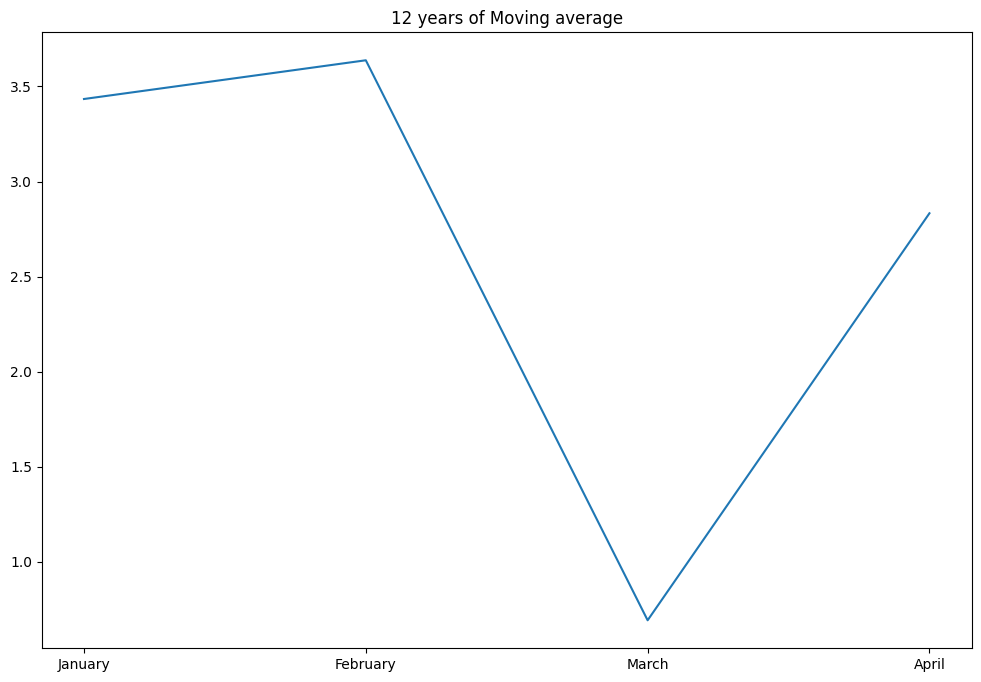

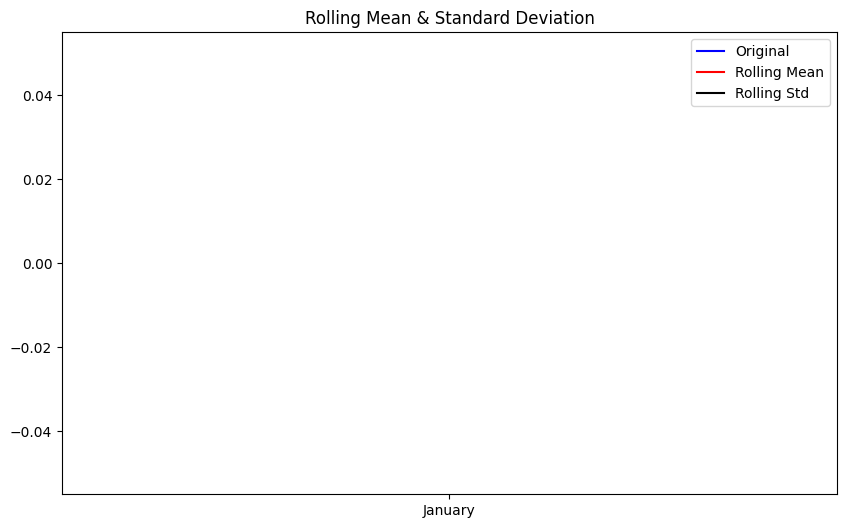

In [ ]:
# Clean column names to remove any leading/trailing spaces or special characters
time_series_df.columns = time_series_df.columns.str.strip()

# Plotting the monthly count for each topic again after cleaning
#plt.figure(figsize=(12, 8))
#plt.plot(['January', 'February', 'March', 'April'], row[['January', 'February', 'March', 'April']], label=row['Topic'], marker='o')
for index, row in time_series_df.iterrows():
    if index == 3:  # Selecting the 4th topic as mentioned
        # Pass only the monthly count data (numeric values)
        topic_series = row[['January', 'February', 'March', 'April']].astype(float)
        #test_stationarity(topic_series)
        ts_log = np.log(topic_series)
        moving_avg = ts_log.rolling(12).mean()
        plt.figure(figsize=(12, 8))
        plt.plot(ts_log)
        plt.title('12 years of Moving average')
        plt.plot(moving_avg, color='green')
        plt.show()
        ts_log_moving_avg_diff = ts_log - moving_avg
        #ts_log_moving_avg_diff.dropna(inplace=True)
        test_stationarity(ts_log_moving_avg_diff)


      # plt.plot(['January', 'February', 'March', 'April'], row[['January', 'February', 'March', 'April']], label=row['Topic'], marker='o')
      # plt.xlabel('Month')
      # plt.ylabel('Count')
      # plt.title('Monthly Count for Each Topic')
      # plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
      # plt.grid(True)
      # plt.tight_layout()
      # plt.show()




In [ ]:
def test_stationarity(timeseries):
    # Determining rolling statistics
    rolmean = timeseries.rolling(window=2).mean()  # Rolling window adjusted for short time-series
    rolstd = timeseries.rolling(window=2).std()

    # Plot rolling statistics
    plt.figure(figsize=(10, 6))
    orig = plt.plot(timeseries, color='blue', label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show()

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
<ipython-input-3-312cae824546>:44: FutureWarning: 'M' is deprecated and will be removed in a future

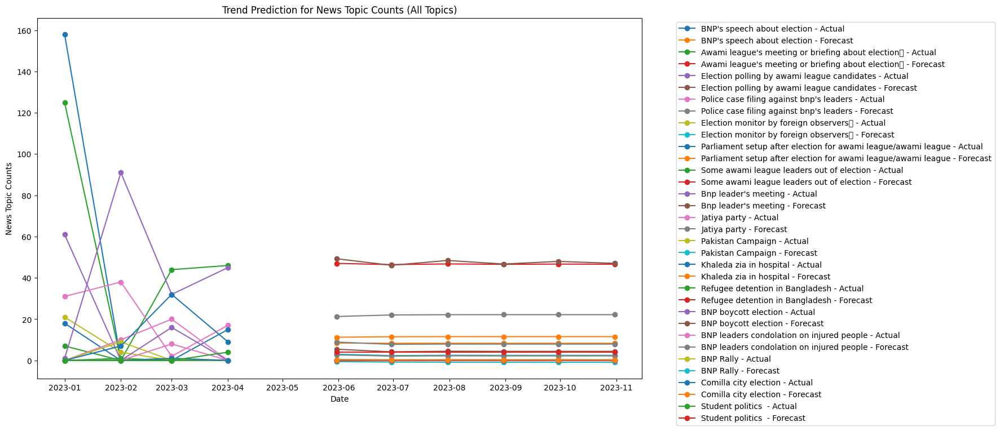

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA

file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

reshaped_data = []
for index, row in time_series_data.iterrows():
    for month in ['January', 'February', 'March', 'April']:
        reshaped_data.append({
            'ds': f"2023-{str(['January', 'February', 'March', 'April'].index(month) + 1).zfill(2)}-01",
            'y': row[month],
            'topic': row['Topic']
        })

df_prophet = pd.DataFrame(reshaped_data)

forecasts_per_topic = {}

for topic in time_series_data['Topic'].unique():
    topic_data = df_prophet[df_prophet['topic'] == topic].groupby('ds')['y'].sum().reset_index()
    topic_data['ds'] = pd.to_datetime(topic_data['ds'])
    topic_data.set_index('ds', inplace=True)

    if len(topic_data) < 3:
        continue

    model_arima = ARIMA(topic_data['y'], order=(1, 1, 1))
    arima_result = model_arima.fit()

    forecast_steps = 6
    forecast_arima = arima_result.get_forecast(steps=forecast_steps)
    forecast_index = pd.date_range(start=topic_data.index[-1] + pd.DateOffset(months=1), periods=forecast_steps, freq='M')
    forecast_mean = forecast_arima.predicted_mean

    forecasts_per_topic[topic] = (topic_data, forecast_index, forecast_mean)

plt.figure(figsize=(18, 8))
for topic, (topic_data, forecast_index, forecast_mean) in forecasts_per_topic.items():
    plt.plot(topic_data.index, topic_data['y'], label=f'{topic} - Actual', marker='o')
    plt.plot(forecast_index, forecast_mean, label=f'{topic} - Forecast', marker='o')

plt.title('Trend Prediction for News Topic Counts (All Topics)')
plt.xlabel('Date')
plt.ylabel('News Topic Counts')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


In [ ]:
pip install tensorflow

Forecasting for topic: BNP's speech about election


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


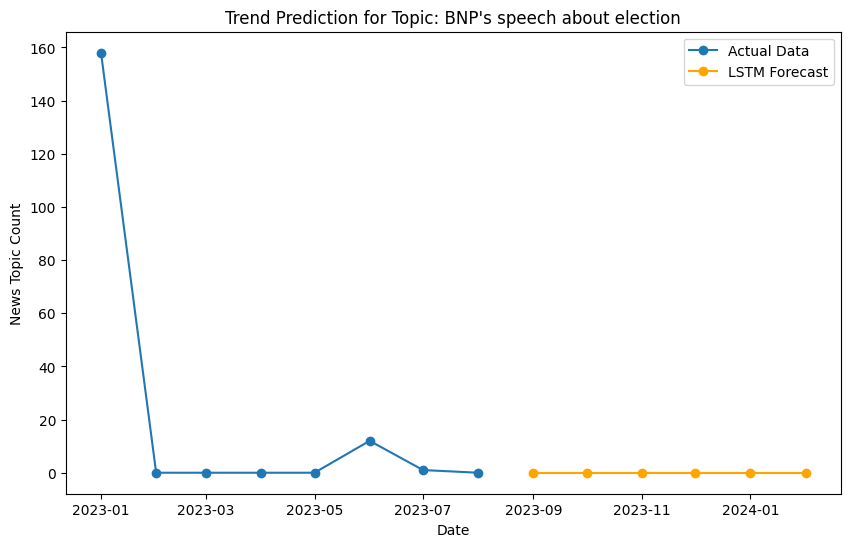

Forecasting for topic: Awami league's meeting or briefing about election	


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


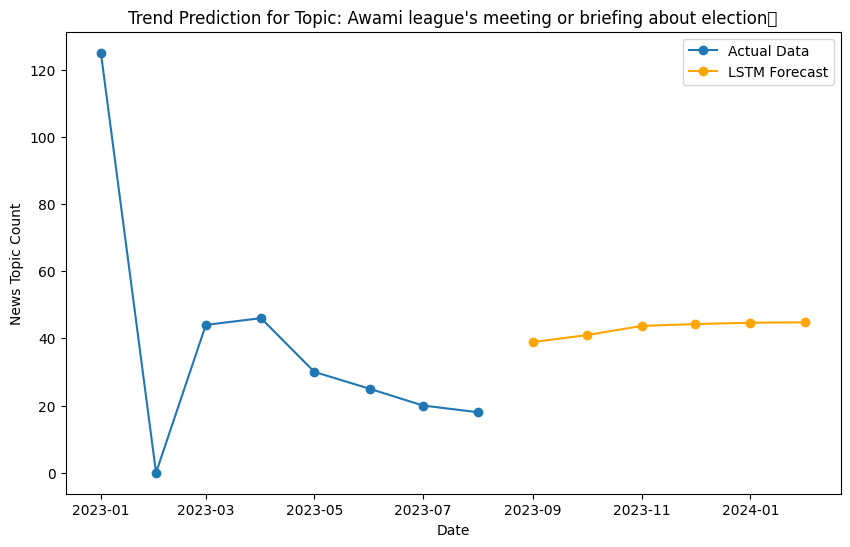

Forecasting for topic: Election polling by awami league candidates


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


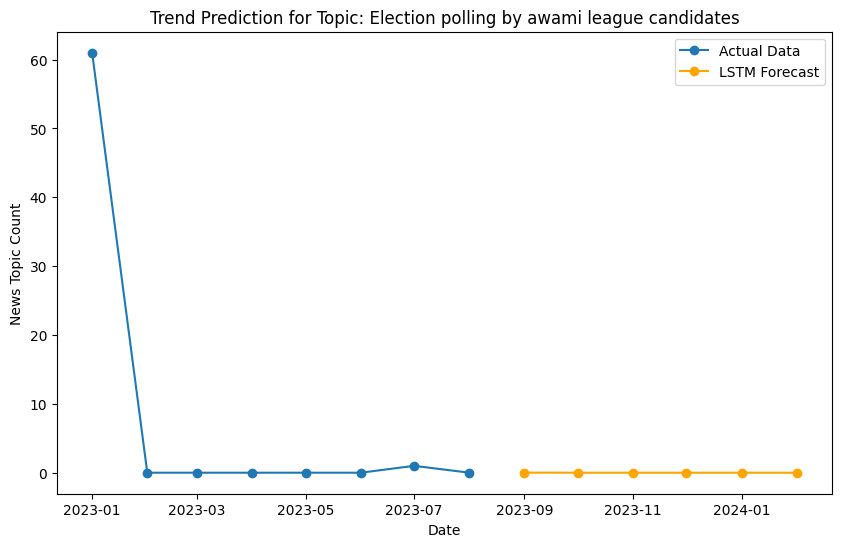

Forecasting for topic: Police case filing against bnp's leaders


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


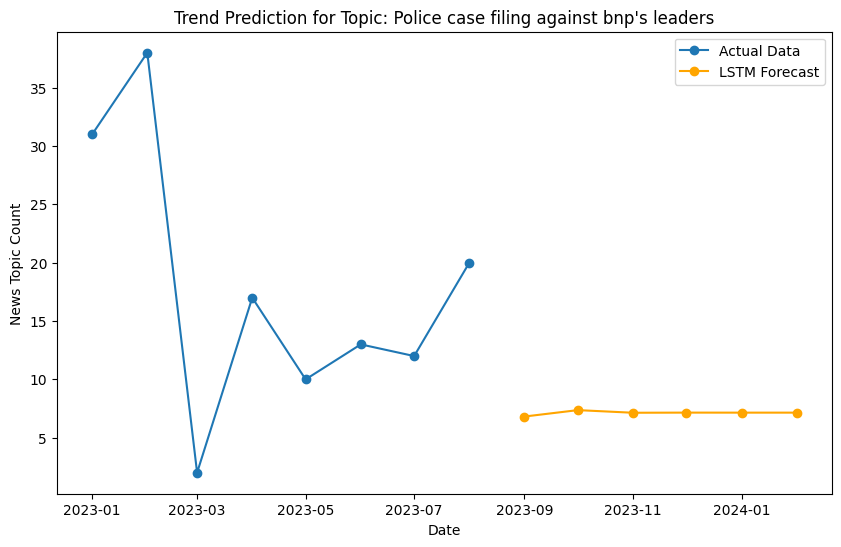

Forecasting for topic: Election monitor by foreign observers	


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


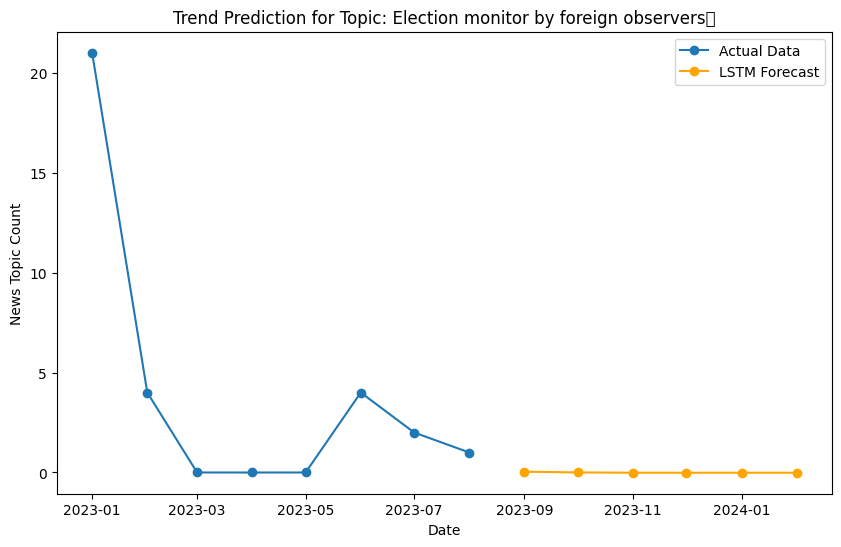

Forecasting for topic: Parliament setup after election for awami league/awami league


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


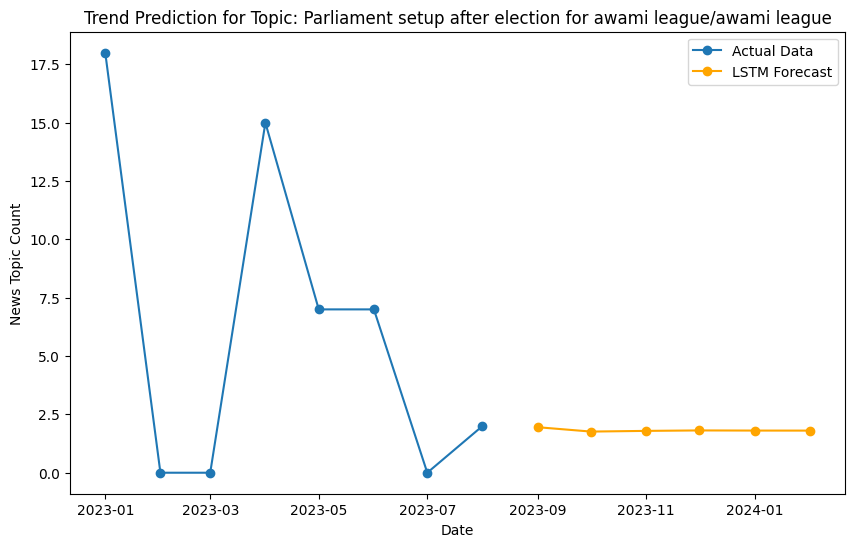

Forecasting for topic: Some awami league leaders out of election


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


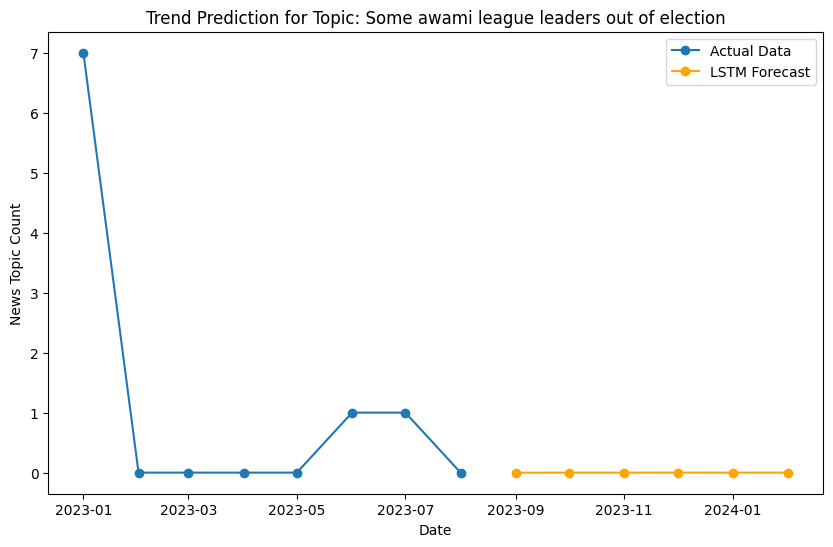

Forecasting for topic: Bnp leader's meeting


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


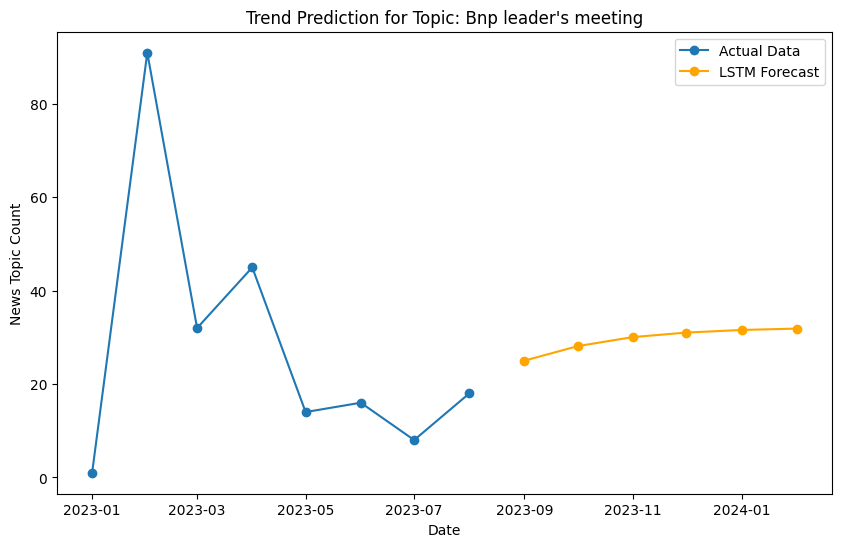

Forecasting for topic: Jatiya party


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


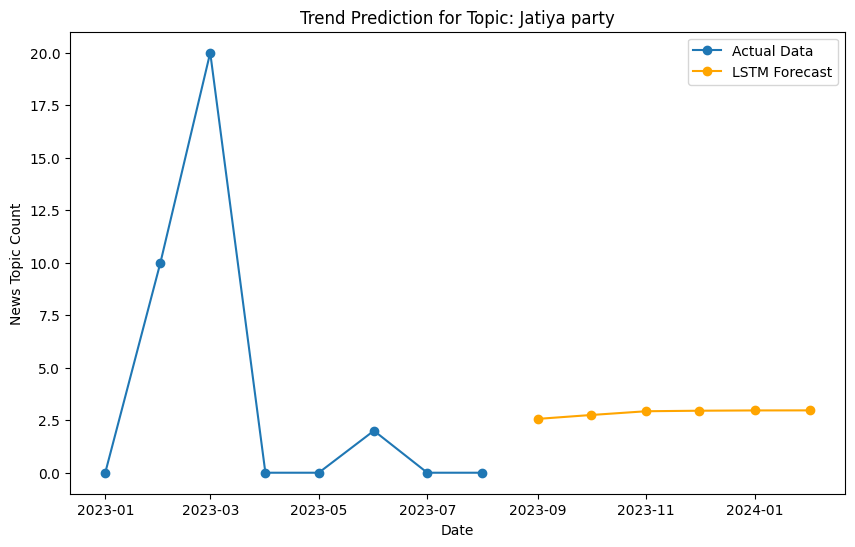

Forecasting for topic: Pakistan Campaign


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


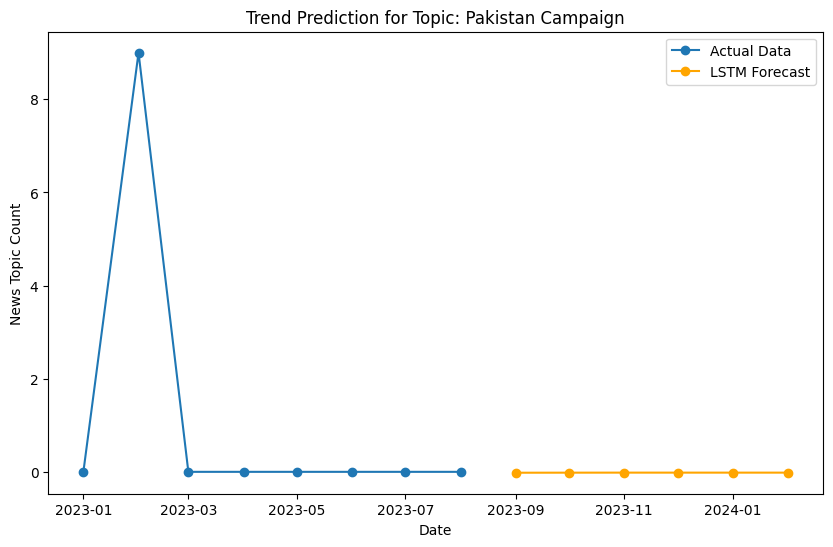

Forecasting for topic: Khaleda zia in hospital


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


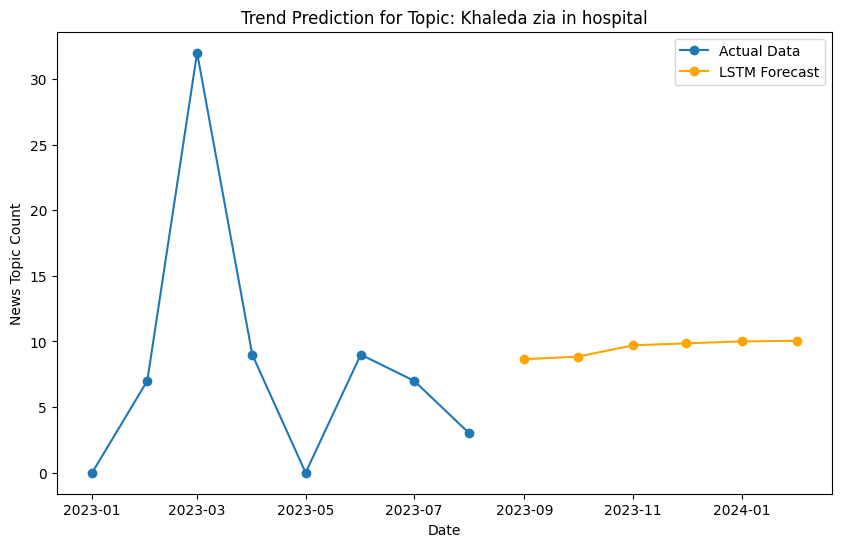

Forecasting for topic: Refugee detention in Bangladesh


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


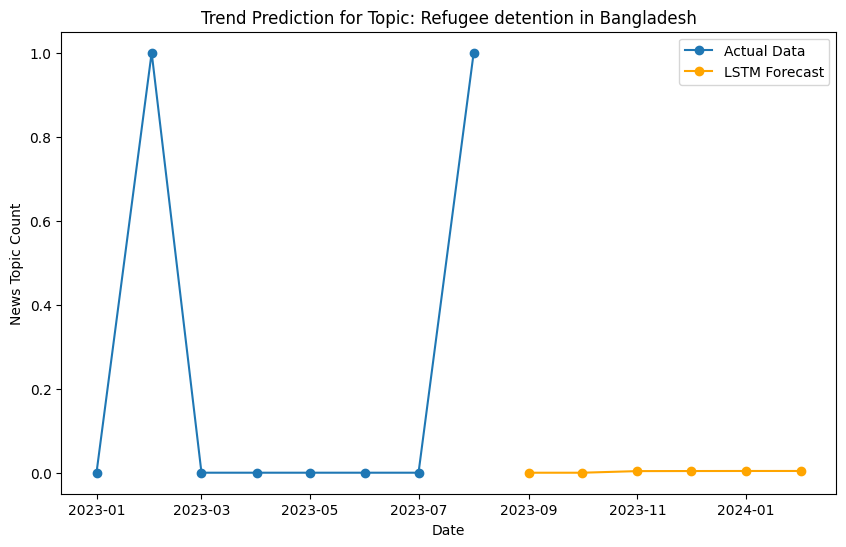

Forecasting for topic: BNP boycott election


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


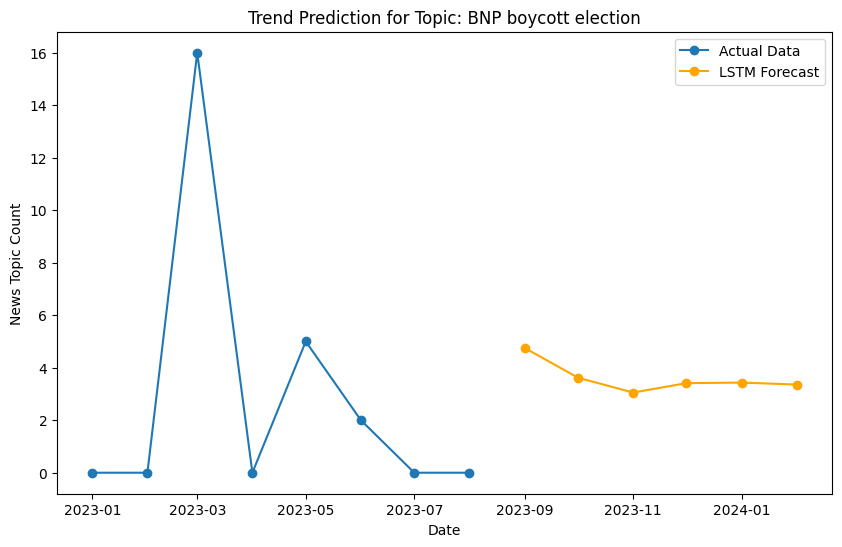

Forecasting for topic: BNP leaders condolation on injured people


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


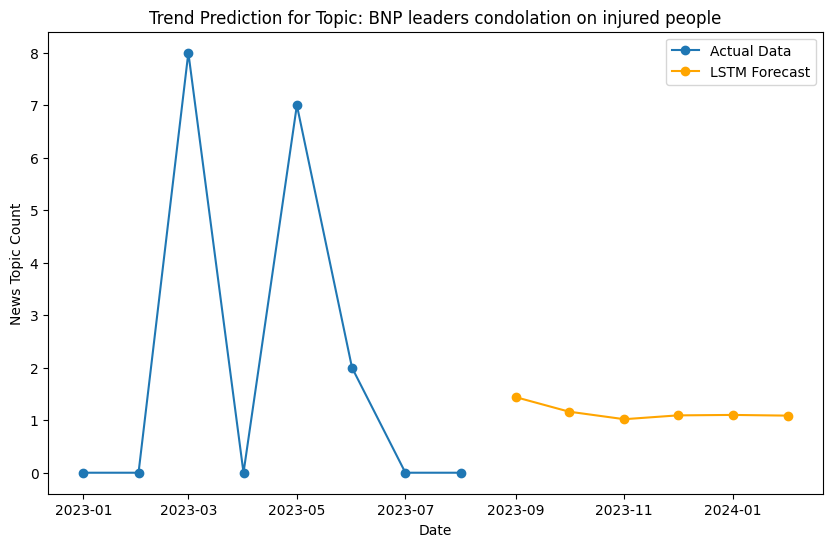

Forecasting for topic: BNP Rally


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


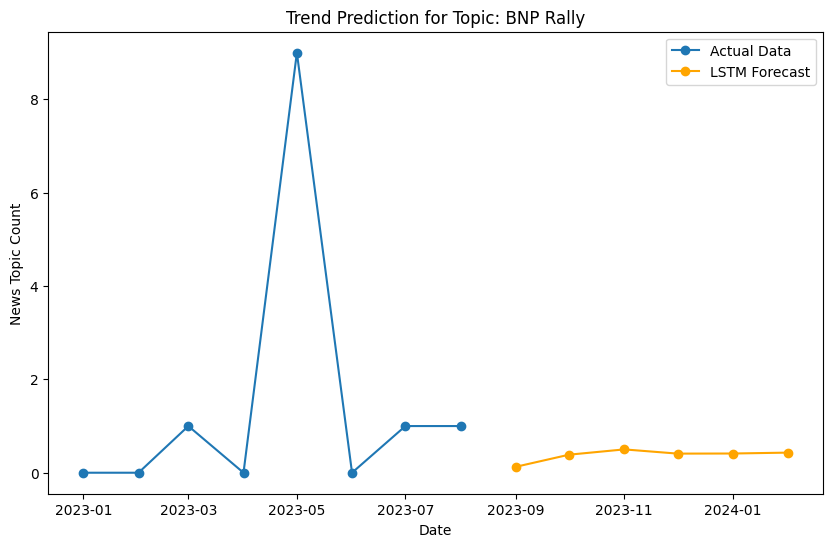

Forecasting for topic: Comilla city election


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


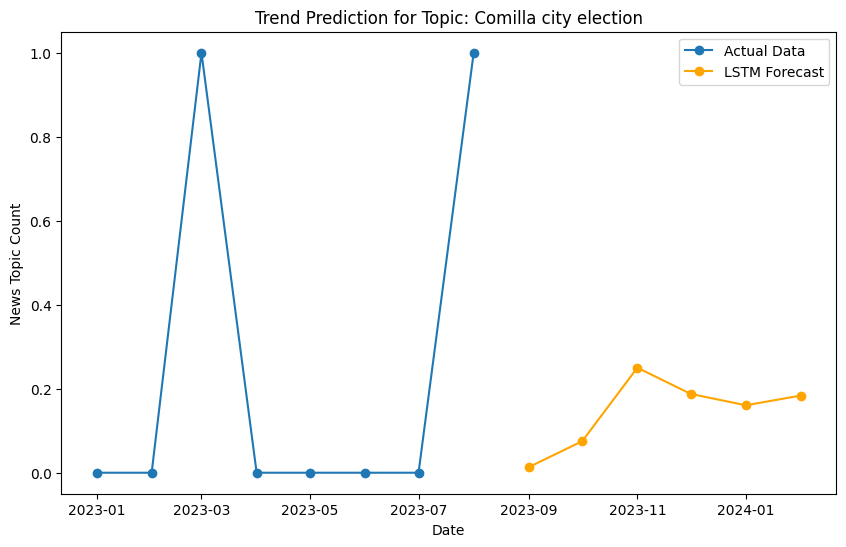

Forecasting for topic: Student politics 


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


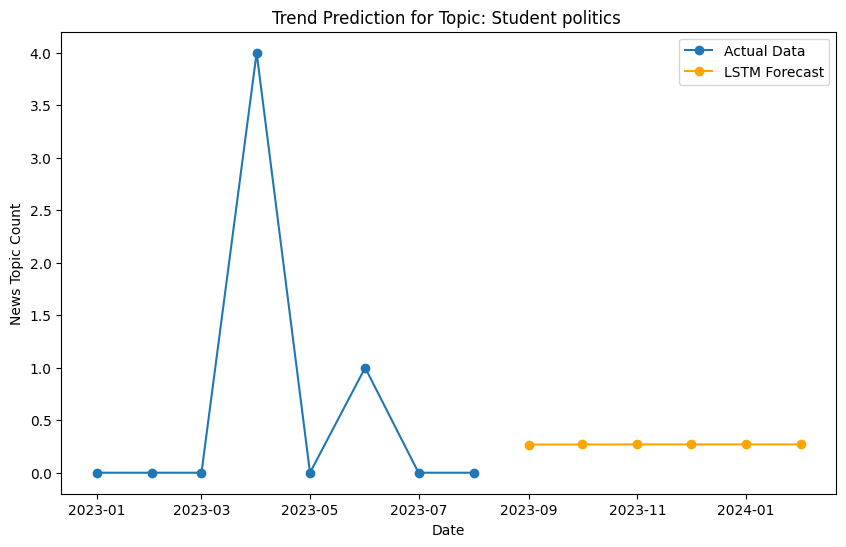

In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM

file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

def forecast_lstm_for_each_topic(data, time_steps=2, forecast_steps=6, epochs=50, batch_size=1):
    for index, row in data.iterrows():
        topic = row['Topic']
        print(f"Forecasting for topic: {topic}")

        values = [row['January'], row['February'], row['March'], row['April']]
        dates = pd.date_range(start="2023-01-01", periods=len(values), freq='MS')
        topic_df = pd.DataFrame({'ds': dates, 'y': values})

        scaler = MinMaxScaler(feature_range=(0, 1))
        data_scaled = scaler.fit_transform(np.array(values).reshape(-1, 1))

        X_train, y_train = [], []
        for i in range(time_steps, len(data_scaled)):
            X_train.append(data_scaled[i - time_steps:i, 0])
            y_train.append(data_scaled[i, 0])

        X_train, y_train = np.array(X_train), np.array(y_train)
        X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))  # Reshape to (samples, time_steps, features)

        model = Sequential()
        model.add(LSTM(50, activation='relu', input_shape=(X_train.shape[1], 1)))
        model.add(Dense(1))
        model.compile(optimizer='adam', loss='mse')

        model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

        predictions = []
        input_data = data_scaled[-time_steps:].reshape(1, time_steps, 1)

        for _ in range(forecast_steps):
            pred = model.predict(input_data, verbose=0)[0, 0]
            predictions.append(pred)
            input_data = np.append(input_data[:, 1:, :], [[[pred]]], axis=1)

        predictions = scaler.inverse_transform(np.array(predictions).reshape(-1, 1)).flatten()

        forecast_dates = pd.date_range(start=topic_df['ds'].iloc[-1] + pd.DateOffset(months=1), periods=forecast_steps, freq='MS')
        forecast_df = pd.DataFrame({'ds': forecast_dates, 'yhat': predictions})

        plt.figure(figsize=(10, 6))
        plt.plot(topic_df['ds'], topic_df['y'], label='Actual Data', marker='o')
        plt.plot(forecast_df['ds'], forecast_df['yhat'], label='LSTM Forecast', color='orange', marker='o')
        plt.title(f'Trend Prediction for Topic: {topic}')
        plt.xlabel('Date')
        plt.ylabel('News Topic Count')
        plt.legend()
        plt.show()

forecast_lstm_for_each_topic(time_series_data)


[{'ds': '2023-01-01', 'y': 158, 'topic': "BNP's speech about election"}, {'ds': '2023-02-01', 'y': 0, 'topic': "BNP's speech about election"}, {'ds': '2023-03-01', 'y': 0, 'topic': "BNP's speech about election"}, {'ds': '2023-04-01', 'y': 0, 'topic': "BNP's speech about election"}, {'ds': '2023-01-01', 'y': 125, 'topic': "Awami league's meeting or briefing about election\t"}, {'ds': '2023-02-01', 'y': 0, 'topic': "Awami league's meeting or briefing about election\t"}, {'ds': '2023-03-01', 'y': 44, 'topic': "Awami league's meeting or briefing about election\t"}, {'ds': '2023-04-01', 'y': 46, 'topic': "Awami league's meeting or briefing about election\t"}, {'ds': '2023-01-01', 'y': 61, 'topic': 'Election polling by awami league candidates'}, {'ds': '2023-02-01', 'y': 0, 'topic': 'Election polling by awami league candidates'}, {'ds': '2023-03-01', 'y': 0, 'topic': 'Election polling by awami league candidates'}, {'ds': '2023-04-01', 'y': 0, 'topic': 'Election polling by awami league candid

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
<ipython-input-16-f8b31d52a454>:35: FutureWarning: 'M' is deprecated and will be removed in a futur

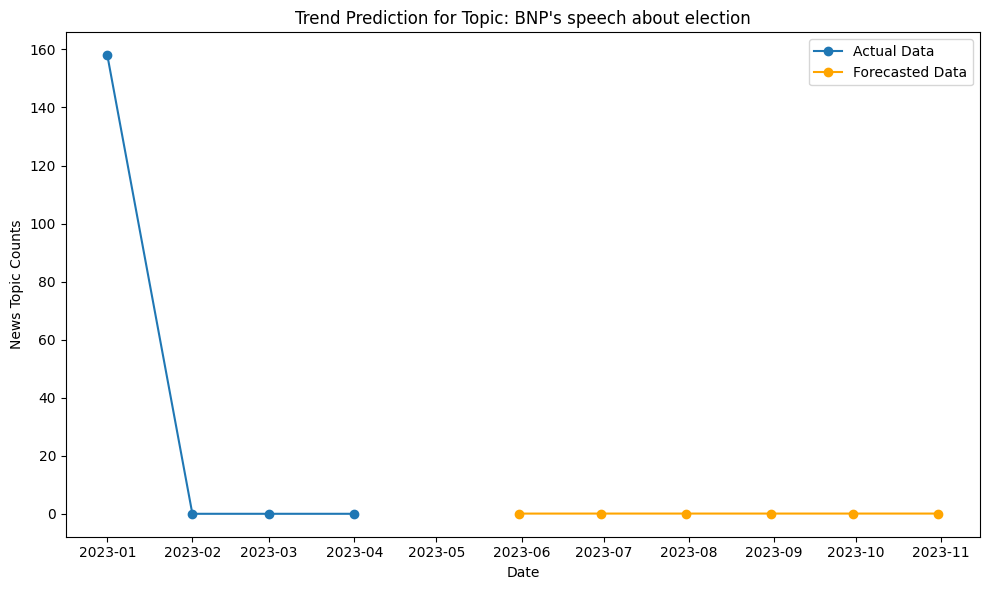

<ipython-input-16-f8b31d52a454>:48: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


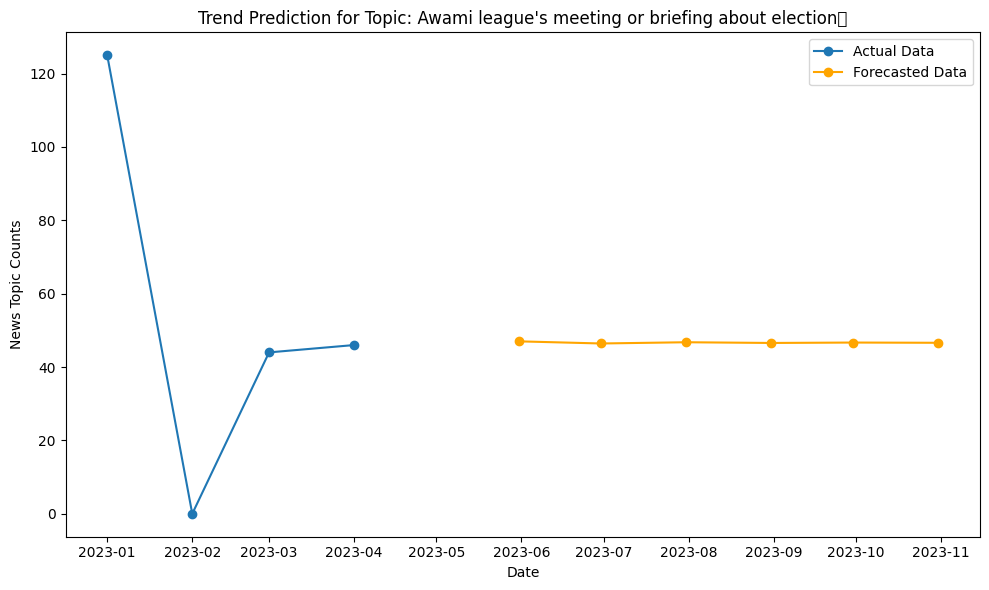

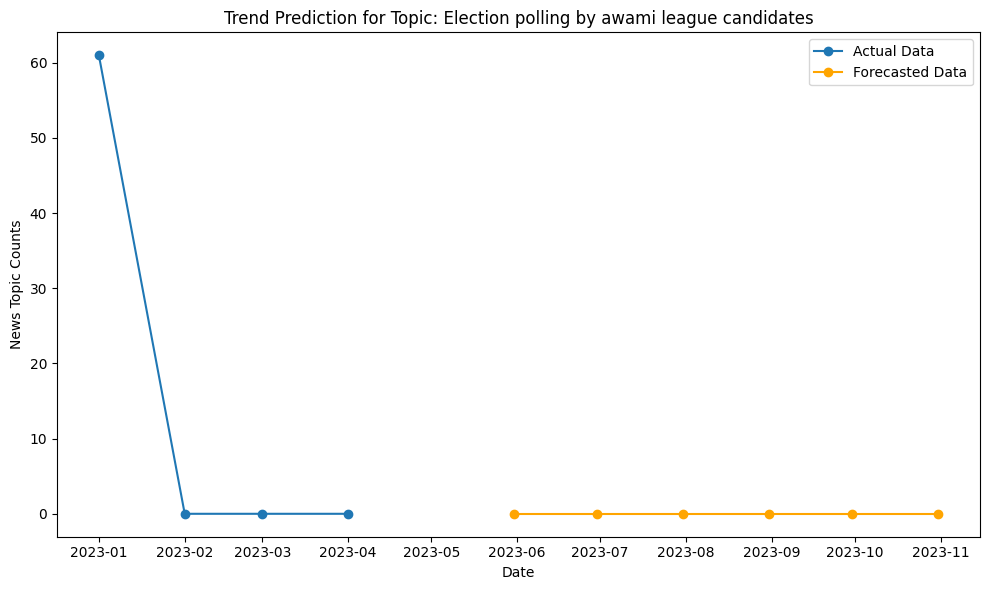

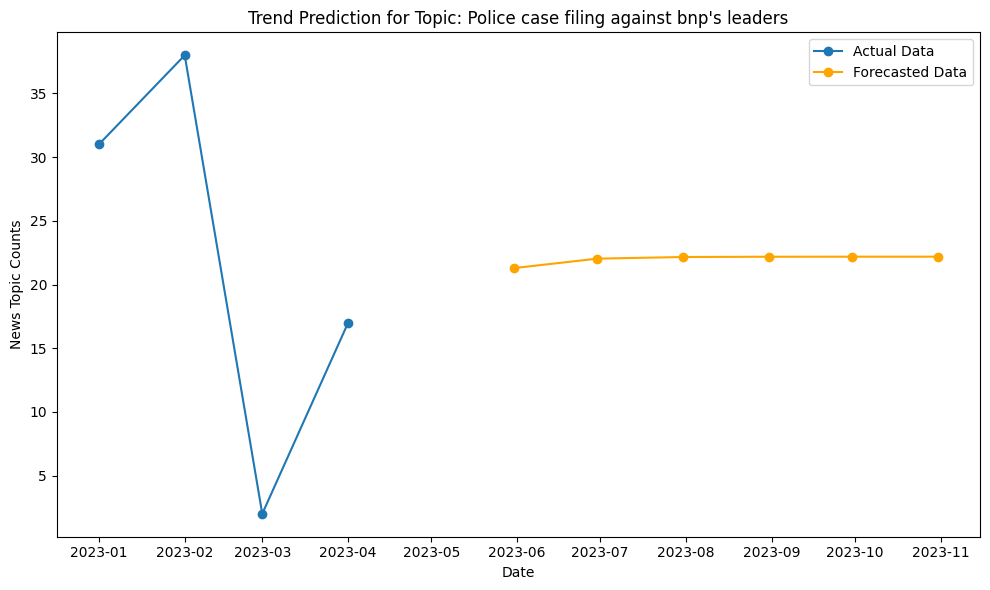

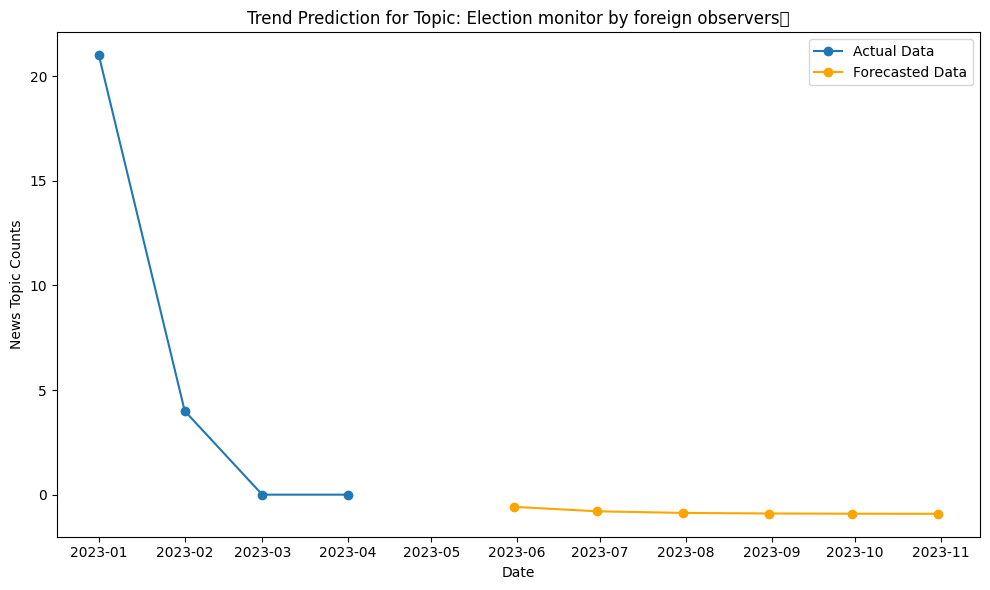

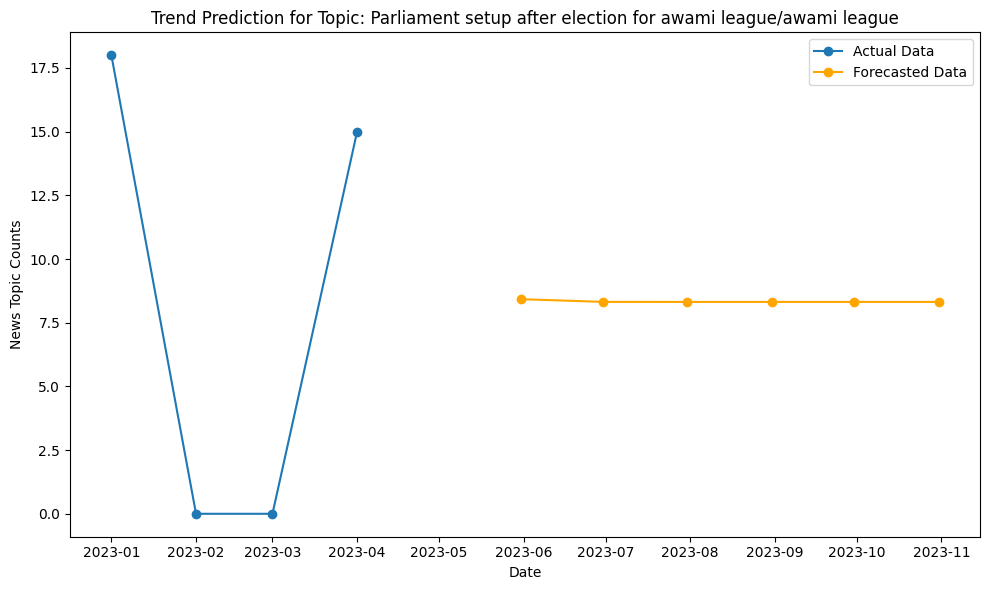

...

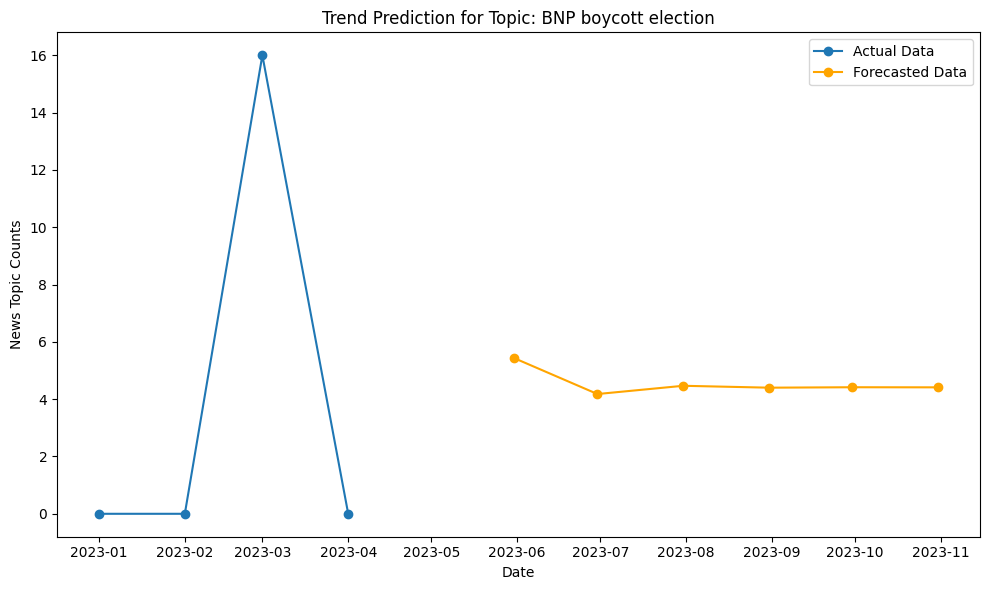

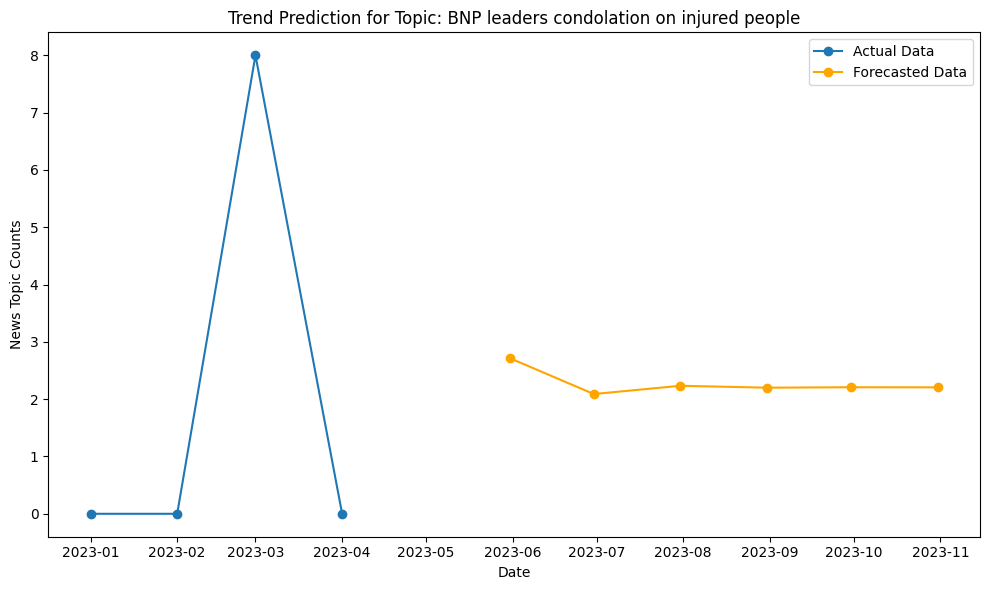

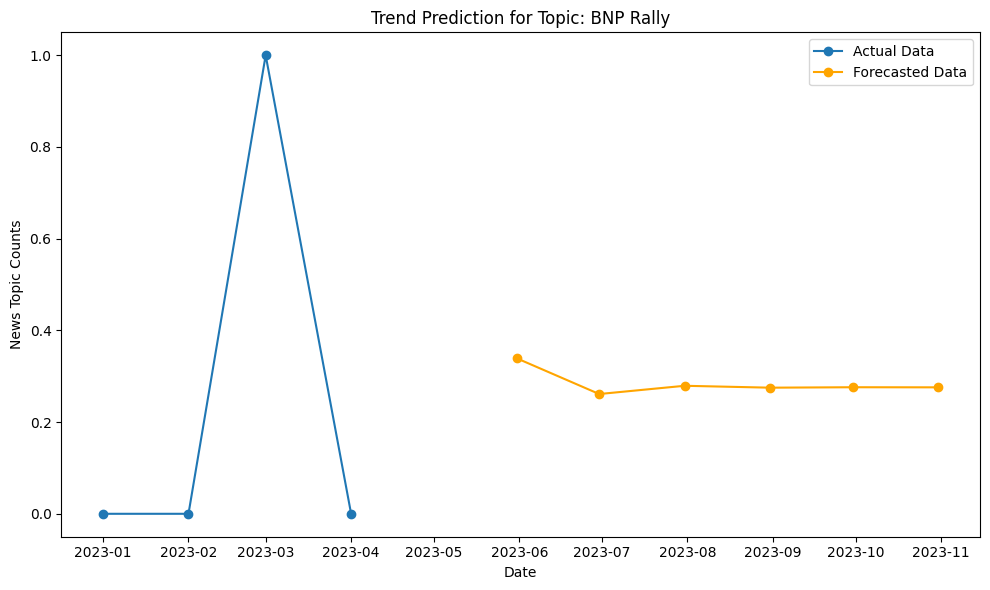

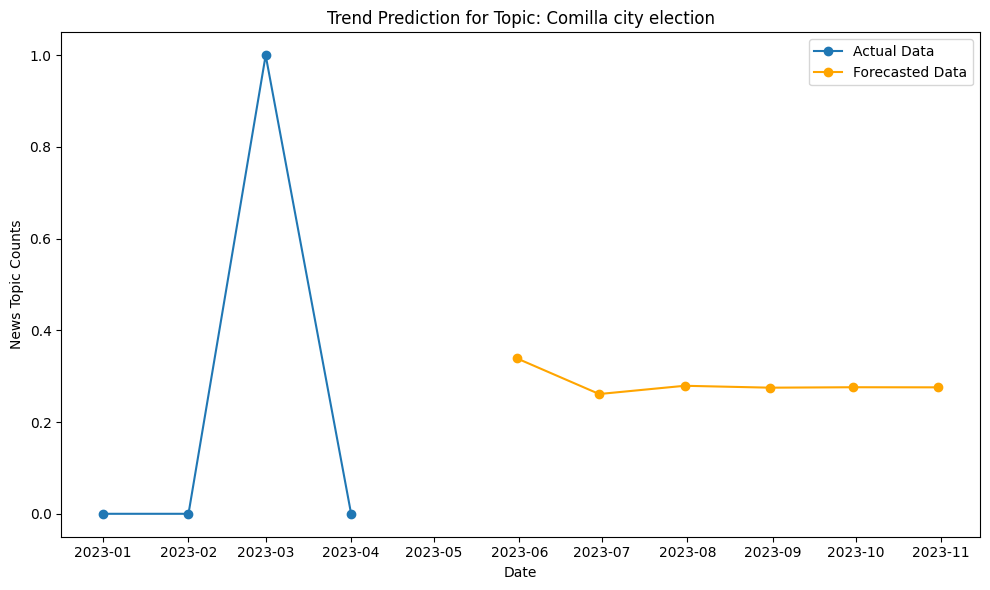

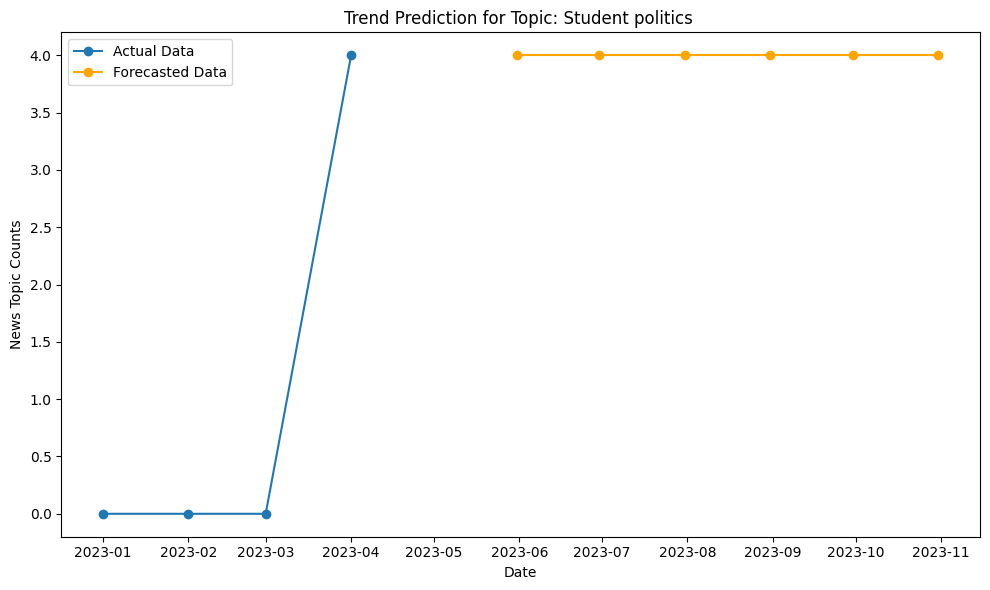

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA

file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

reshaped_data = []
for index, row in time_series_data.iterrows():
    for month in ['January', 'February', 'March', 'April']:
        reshaped_data.append({
            'ds': f"2023-{str(['January', 'February', 'March', 'April'].index(month) + 1).zfill(2)}-01",
            'y': row[month],
            'topic': row['Topic']
        })
print(reshaped_data)

df_prophet = pd.DataFrame(reshaped_data)

forecasts_per_topic = {}

for topic in time_series_data['Topic'].unique():
    topic_data = df_prophet[df_prophet['topic'] == topic].groupby('ds')['y'].sum().reset_index()
    topic_data['ds'] = pd.to_datetime(topic_data['ds'])
    topic_data.set_index('ds', inplace=True)

    if len(topic_data) < 3:
        continue

    model_arima = ARIMA(topic_data['y'], order=(1, 1, 1))
    arima_result = model_arima.fit()

    forecast_steps = 6
    forecast_arima = arima_result.get_forecast(steps=forecast_steps)
    forecast_index = pd.date_range(start=topic_data.index[-1] + pd.DateOffset(months=1), periods=forecast_steps, freq='M')
    forecast_mean = forecast_arima.predicted_mean

    forecasts_per_topic[topic] = (topic_data, forecast_index, forecast_mean)

for topic, (topic_data, forecast_index, forecast_mean) in forecasts_per_topic.items():
    plt.figure(figsize=(10, 6))
    plt.plot(topic_data.index, topic_data['y'], label='Actual Data', marker='o')
    plt.plot(forecast_index, forecast_mean, label='Forecasted Data', color='orange', marker='o')
    plt.title(f'Trend Prediction for Topic: {topic}')
    plt.xlabel('Date')
    plt.ylabel('News Topic Counts')
    plt.legend()
    plt.tight_layout()
    plt.show()


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
<ipython-input-14-c982db57c41c>:44: FutureWarning: 'M' is deprecated and will be removed in a futur

Skipping topic 'BNP's speech about election' as no test data is available.
Skipping topic 'Awami league's meeting or briefing about election	' as no test data is available.
Skipping topic 'Election polling by awami league candidates' as no test data is available.
Skipping topic 'Police case filing against bnp's leaders' as no test data is available.


<ipython-input-14-c982db57c41c>:44: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  forecast_index = pd.date_range(start=topic_data.index[-1] + pd.DateOffset(months=1), periods=forecast_steps, freq='M')
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starti

In [ ]:
# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error,mean_absolute_error
import numpy as np

# Load the uploaded CSV file
file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

# Reshape the data for time-series analysis
reshaped_data = []
for index, row in time_series_data.iterrows():
    for month in ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August']:
        reshaped_data.append({
            'ds': f"2023-{str(['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August'].index(month) + 1).zfill(2)}-01",
            'y': row[month],
            'topic': row['Topic']
        })

# Convert reshaped_data to DataFrame
df = pd.DataFrame(reshaped_data)
df['ds'] = pd.to_datetime(df['ds'])
index = 1

# Loop through each unique topic and perform ARIMA forecasting
for topic in df['topic'].unique():
    print(f"\nTopic: {topic}")

    # Filter data for this topic
    topic_data = df[df['topic'] == topic].groupby('ds')['y'].sum().reset_index()
    topic_data.set_index('ds', inplace=True)

    # Split data into training and testing sets
    size = int(len(topic_data) * 0.5)
    train, test = topic_data['y'][:size], topic_data['y'][size:]

    # Convert to list for compatibility with ARIMA training
    history = list(train)
    predictions_arima = []

    # Perform ARIMA forecasting
    for t in range(len(test)):
        model = ARIMA(history, order=(5, 1, 0))
        model_fit = model.fit()
        output = model_fit.forecast()
        yhat = output[0]
        predictions_arima.append(yhat)
        obs = test.iloc[t]
        history.append(obs)
        print('predicted=%f, expected=%f' % (yhat, obs))
    #print("index :" + index)
    print(predictions_arima)
    print("\n")

    # Evaluate forecasts
    #rmse = np.sqrt(mean_squared_error(test, predictions_arima))
    #print(f'Test RMSE for {topic}: {rmse:.3f}')
    #Evaluate MAPE

    mae = mean_absolute_error(test,predictions_arima)
    print("Mean Absolute Error ARIMA \n")
    print(mae)


    # Plot forecasts against actual outcomes for this topic
    #plt.figure(figsize=(10, 6))
    #plt.plot(test.index, test.values, label='Actual', marker='o')
    #plt.plot(test.index, predictions_arima, color='red', label='Predicted', marker='o')
    #plt.title(f'ARIMA Forecast vs Actual Data for Topic: {topic}')
    #plt.xlabel('Date')
    #plt.ylabel('News Topic Counts')
    #plt.legend()
    #plt.tight_layout()
    #plt.show()




Topic: BNP's speech about election


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=145.802713, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=145.779977, expected=3.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=146.722655, expected=0.000000
predicted=0.069192, expected=0.000000
[145.80271319651055, 145.77997650353572, 146.72265509867248, 0.0691917856233358]


Mean Absolute Error ARIMA 

108.84363414608552

Topic: Awami league's meeting or briefing about election	


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=-38.417449, expected=12.000000
predicted=67.878899, expected=27.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=47.763150, expected=29.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=-1.386722, expected=105.000000
[-38.41744909734908, 67.87889887930109, 47.763149650095215, -1.3867223114147542]


Mean Absolute Error ARIMA 

54.111554984540035

Topic: Election polling by awami league candidates
predicted=0.242295, expected=0.000000
predicted=0.085945, expected=0.000000
predicted=0.076367, expected=0.000000
predicted=-0.000000, expected=0.000000
[0.24229504742828423, 0.0859445011962947, 0.07636701832446197, -1.2531883045252982e-19]


Mean Absolute Error ARIMA 

0.10115164173726023

Topic: Police case filing against bnp's leaders


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=-23.820567, expected=26.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=-10.232120, expected=1.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=28.203611, expected=3.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=11.326208, expected=43.000000
[-23.820567013668523, -10.232119699421158, 28.20361055392368, 11.326207892453215]


Mean Absolute Error ARIMA 

29.48252234364004

Topic: Election monitor by foreign observers	
predicted=1.118199, expected=3.000000
predicted=6.510752, expected=20.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=24.842629, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=4.519641, expected=0.000000
[1.1181988562709193, 6.510752136325028, 24.842628655212323, 4.519641409089558]


Mean Absolute Error ARIMA 

11.183329767926484

Topic: Parliament setup after election for awami league/awami league
predicted=16.787787, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.005909, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=17.999233, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=7.645676, expected=0.000000
[16.78778658725327, 0.005908701578519526, 17.99923271833008, 7.6456758786407395]


Mean Absolute Error ARIMA 

10.609650971450652

Topic: Some awami league leaders out of election
predicted=0.000005, expected=0.000000
predicted=0.000148, expected=0.000000
predicted=-0.000002, expected=0.000000
predicted=0.000000, expected=0.000000
[4.6036257185708856e-06, 0.000147844903177431, -1.6150174240257042e-06, 6.723438459192704e-16]


Mean Absolute Error ARIMA 

3.851588658017499e-05

Topic: Bnp leader's meeting


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=81.306797, expected=133.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=71.810782, expected=77.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=86.534744, expected=28.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=99.983778, expected=93.000000
[81.30679738951345, 71.81078208563488, 86.53474428048074, 99.98377755507958]


Mean Absolute Error ARIMA 

30.600235590102997

Topic: Jatiya party


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=9.999843, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=16.663039, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=23.271756, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=19.977385, expected=0.000000
[9.999842577717072, 16.663039361926824, 23.27175623922566, 19.97738494889151]


Mean Absolute Error ARIMA 

17.478005781940265

Topic: Pakistan Campaign


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=8.999884, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=8.999564, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=8.997606, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=8.993641, expected=0.000000
[8.99988370269958, 8.999563784330832, 8.997606237267751, 8.99364062952488]


Mean Absolute Error ARIMA 

8.997673588455761

Topic: Khaleda zia in hospital


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=-1.279141, expected=12.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=39.153422, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=32.043585, expected=7.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=32.003588, expected=0.000000
[-1.2791412679162981, 39.15342152042239, 32.043585256198995, 32.0035880529744]


Mean Absolute Error ARIMA 

27.36993402437802

Topic: Refugee detention in Bangladesh


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.999801, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.999614, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.999079, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=0.999358, expected=0.000000
[0.9998009053638852, 0.9996138933592967, 0.9990785361936809, 0.999357821960918]


Mean Absolute Error ARIMA 

0.9994627892194452

Topic: BNP boycott election
predicted=0.000059, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=16.000223, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=15.994818, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=15.992664, expected=0.000000
[5.871271974200454e-05, 16.00022283888805, 15.99481803821127, 15.992664160278046]


Mean Absolute Error ARIMA 

11.996940937524277

Topic: BNP leaders condolation on injured people
predicted=0.000013, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=8.000043, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=7.999152, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=7.999575, expected=0.000000
[1.3469582601288721e-05, 8.000042600695796, 7.999151909502454, 7.9995747570876015]


Mean Absolute Error ARIMA 

5.999695684217113

Topic: BNP Rally
predicted=0.000152, expected=0.000000
predicted=0.994345, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=0.999589, expected=54.000000
predicted=54.085027, expected=0.000000
[0.00015154183529308973, 0.9943446992785978, 0.9995887165533365, 54.085027076810555]


Mean Absolute Error ARIMA 

27.01998365034278

Topic: Comilla city election
predicted=0.000152, expected=0.000000
predicted=0.994345, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.999589, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=0.992595, expected=0.000000
[0.00015154183529308973, 0.9943446992785978, 0.9995887165533365, 0.9925946946554974]


Mean Absolute Error ARIMA 

0.7466699130806812

Topic: Student politics 
predicted=4.000021, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.000934, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=-0.001568, expected=5.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=2.220045, expected=0.000000
[4.000020620286751, 0.0009342584684350896, -0.001567946178897796, 2.220044991681123]


Mean Absolute Error ARIMA 

2.8056419541538014

Topic: Annual Budget and Inflation
predicted=0.000000, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=0.000000, expected=27.000000
predicted=26.998811, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=-2.642571, expected=0.000000
[0.0, 0.0, 26.998810642338658, -2.642570870408896]


Mean Absolute Error ARIMA 

14.160345378186888

Topic: Awami League leader's murder
predicted=0.000000, expected=6.000000
predicted=6.000038, expected=6.000000
predicted=6.000031, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=-0.000141, expected=0.000000
[0.0, 6.000038382942343, 6.000031135052366, -0.00014086982480665533]


Mean Absolute Error ARIMA 

3.0000525969548786

Topic: Upazilla election


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.000000, expected=53.000000
predicted=53.000073, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=-5.325122, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


predicted=-0.064686, expected=6.000000
[0.0, 53.00007277990981, -5.325122469607095, -0.06468561500504458]


Mean Absolute Error ARIMA 

29.347470216130485

Topic: Labor movement


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.000000, expected=13.000000
predicted=13.000105, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=3.196881, expected=16.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=14.069854, expected=0.000000
[0.0, 13.000104513032923, 3.1968808873303463, 14.069854288256149]


Mean Absolute Error ARIMA 

13.218269478489681

Topic: Corruption of army officers
predicted=0.000000, expected=4.000000
predicted=4.000020, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=2.450072, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=-0.000436, expected=0.000000
[0.0, 4.0000195267252385, 2.450072257484675, -0.0004364002227506001]


Mean Absolute Error ARIMA 

2.6126320461081662

Topic: Israel palestine war
predicted=0.000000, expected=1.000000
predicted=1.000000, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.789903, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.000033, expected=0.000000
[0.0, 1.0000000000012255, 0.7899027986163036, 3.2849349724586384e-05]


Mean Absolute Error ARIMA 

0.6974839119918135

Topic: jamaat e islami shibir
predicted=0.000000, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.000000, expected=0.000000
predicted=0.000000, expected=13.000000
predicted=13.000060, expected=24.000000
[0.0, 0.0, 0.0, 13.000060246064423]


Mean Absolute Error ARIMA 

5.999984938483895

Topic: Quota movement
predicted=0.000000, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.000000, expected=0.000000
predicted=0.000000, expected=7.000000
predicted=7.000033, expected=0.000000
[0.0, 0.0, 0.0, 7.000032552483648]


Mean Absolute Error ARIMA 

3.5000081381209123

Topic: Yunus as cheif advisor
predicted=0.000000, expected=0.000000


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.000000, expected=0.000000
predicted=0.000000, expected=0.000000
predicted=0.000000, expected=31.000000
[0.0, 0.0, 0.0, 0.0]


Mean Absolute Error ARIMA 

7.75


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [ ]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

In [ ]:
# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
import numpy as np

# Load the uploaded CSV file
file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

# Reshape the data for time-series analysis
reshaped_data = []
for index, row in time_series_data.iterrows():
    for month in ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August']:
        reshaped_data.append({
            'ds': f"2023-{str(['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August'].index(month) + 1).zfill(2)}-01",
            'y': row[month],
            'topic': row['Topic']
        })

# Convert reshaped_data to DataFrame
df = pd.DataFrame(reshaped_data)
df['ds'] = pd.to_datetime(df['ds'])

# Loop through each unique topic and perform ARIMA forecasting
for topic in df['topic'].unique():
    print(f"\nTopic: {topic}")

    # Filter data for this topic
    topic_data = df[df['topic'] == topic].groupby('ds')['y'].sum().reset_index()
    topic_data.set_index('ds', inplace=True)

    # Split data into training and testing sets
    size = int(len(topic_data) * 0.5)
    train, test = topic_data['y'][:size], topic_data['y'][size:]

    # Convert to list for compatibility with ARIMA training
    history = list(train)
    predictions_sarima = []

    # Perform ARIMA forecasting
    for t in range(len(test)):
        my_order = (0,1,0)
        my_seasonal_order = (1, 0, 1, 12)
        model = SARIMAX(history, order=my_order, seasonal_order=my_seasonal_order)

        #model = ARIMA(history, order=(5, 1, 0))
        model_fit = model.fit()
        output = model_fit.forecast()
        yhat = output[0]
        predictions_sarima.append(yhat)
        obs = test.iloc[t]
        history.append(obs)
        #print('predicted=%f, expected=%f' % (yhat, obs))
    print(predictions_sarima)
    print("\n")
    #rmse = np.sqrt(mean_squared_error(test, predictions_sarima))
    #print(f'Test RMSE in SARIMA for {topic}: {rmse:.3f}')
    #Evaluate MAPE
    #mape = mean_absolute_percentage_error(test, predictions_sarima)
    #print(f'Test MAPE for {topic}: {mape:.3f}')
    # Evaluate forecasts
    #rmse = np.sqrt(mean_squared_error(test, predictions_sarima))
    #print(f'Test RMSE for {topic}: {rmse:.3f}')
    mae = mean_absolute_error(test,predictions_sarima)
    print("Mean Absolute Error SARIMA \n")
    print(mae)

    # Plot forecasts against actual outcomes for this topic
    #plt.figure(figsize=(10, 6))
    #plt.plot(test.index, test.values, label='Actual', marker='o')
    #plt.plot(test.index, predictions_sarima, color='red', label='Predicted', marker='o')
    #plt.title(f'SARIMA Forecast vs Actual Data for Topic: {topic}')
    #plt.xlabel('Date')
    #plt.ylabel('News Topic Counts')
    #plt.legend()
    #plt.tight_layout()
    #plt.show()



Topic: BNP's speech about election


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[4.32475870059752e-14, -1.4775924699769624e-14, 2.999999999999998, -3.4479132295647293e-15]


Mean Absolute Error SARIMA 

1.5000000000000147

Topic: Awami league's meeting or briefing about election	


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[45.99999999999998, 12.0, 27.000000000000007, 29.000000000000004]


Mean Absolute Error SARIMA 

31.749999999999993

Topic: Election polling by awami league candidates


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[6.600980505367905e-15, 3.421514361033129e-15, -3.2099875818657223e-15, 1.7566931607342673e-16]


Mean Absolute Error SARIMA 

3.352037941085046e-15

Topic: Police case filing against bnp's leaders


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[16.999999999999996, 26.0, 1.0000000000000002, 3.0]


Mean Absolute Error SARIMA 

19.0

Topic: Election monitor by foreign observers	


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[4.415762931091783e-16, 3.0, 20.0, 6.0079865478516216e-15]


Mean Absolute Error SARIMA 

10.000000000000002

Topic: Parliament setup after election for awami league/awami league


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[15.0, -1.7336993233463912e-15, 7.286892399640609e-17, -1.0438073524884124e-16]


Mean Absolute Error SARIMA 

3.7500000000000004

Topic: Some awami league leaders out of election


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[1.1939338821270877e-16, 4.708821720040205e-17, 1.7478109776495788e-17, 1.1105498467753643e-17]


Mean Absolute Error SARIMA 

4.876630341434007e-17

Topic: Bnp leader's meeting


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[45.00000000000001, 133.0, 77.0, 28.000000000000007]


Mean Absolute Error SARIMA 

64.5

Topic: Jatiya party


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[9.794649313001253e-16, -5.484568409278987e-16, 4.726734759301282e-16, -1.3001157633192927e-16]


Mean Absolute Error SARIMA 

5.3265170612252035e-16

Topic: Pakistan Campaign


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[-4.664356724535603e-16, 6.833053141252821e-17, 3.394407266795682e-17, -4.8679129663615387e-17]


Mean Absolute Error SARIMA 

1.5434735154941518e-16

Topic: Khaleda zia in hospital


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[9.0, 11.999999999999998, -1.1242642161487912e-15, 7.000000000000001]


Mean Absolute Error SARIMA 

7.25

Topic: Refugee detention in Bangladesh


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[1.172508922913952e-18, -4.872072501305893e-18, 1.8747906455892054e-21, 6.124647941739963e-21]


Mean Absolute Error SARIMA 

1.5131452157017936e-18

Topic: BNP boycott election
[-2.305870907186585e-16, 1.4841209516254728e-16, 5.021561295321838e-16, 2.1539856652458892e-16]


Mean Absolute Error SARIMA 

2.741384704844946e-16

Topic: BNP leaders condolation on injured people


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[8.548420799464311e-16, 2.705252527087471e-16, 1.64309184218284e-17, 4.281152294732396e-17]


Mean Absolute Error SARIMA 

2.961524435060826e-16

Topic: BNP Rally


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[1.9287275424854334e-16, -3.6946577825221046e-18, 1.9224876438848698e-17, 53.99999999999999]


Mean Absolute Error SARIMA 

27.0

Topic: Comilla city election


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[1.9287275424854334e-16, -3.6946577825221046e-18, 1.9224876438848698e-17, -5.3177073104126465e-18]


Mean Absolute Error SARIMA 

5.527749894508169e-17

Topic: Student politics 


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[4.0, 1.5795131064583573e-16, -1.1678645322010223e-16, 5.000000000000001]


Mean Absolute Error SARIMA 

3.5

Topic: Annual Budget and Inflation


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


[0.0, 0.0, 27.0, -5.201775906123036e-15]


Mean Absolute Error SARIMA 

13.500000000000002

Topic: Awami League leader's murder


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


[0.0, 6.0, 6.0, -3.4821832246497327e-16]


Mean Absolute Error SARIMA 

3.0

Topic: Upazilla election


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


[0.0, 53.00000000000001, -4.996576384597439e-16, 4.4284954949173346e-15]


Mean Absolute Error SARIMA 

28.0

Topic: Labor movement


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[0.0, 13.0, -8.880302851509985e-16, 15.999999999999996]


Mean Absolute Error SARIMA 

14.5

Topic: Corruption of army officers


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


[0.0, 4.0, -5.263682665811727e-17, -7.560744509917223e-17]


Mean Absolute Error SARIMA 

2.0

Topic: Israel palestine war


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


[0.0, 1.0, 1.1105798813583783e-16, 8.58662095687011e-19]


Mean Absolute Error SARIMA 

0.5

Topic: jamaat e islami shibir


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


[0.0, 0.0, 0.0, 13.0]


Mean Absolute Error SARIMA 

6.0

Topic: Quota movement


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/sta

[0.0, 0.0, 0.0, 6.999999999999999]


Mean Absolute Error SARIMA 

3.5

Topic: Yunus as cheif advisor


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


[0.0, 0.0, 0.0, 0.0]


Mean Absolute Error SARIMA 

7.75


In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Bidirectional

# Load the dataset
file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

def forecast_bilstm_for_each_topic(data, time_steps=2, forecast_steps=6, epochs=50, batch_size=1):
    for index, row in data.iterrows():
        topic = row['Topic']
        print(f"Forecasting for topic: {topic}")

        values = [row['January'], row['February'], row['March'], row['April']]
        dates = pd.date_range(start="2023-01-01", periods=len(values), freq='MS')
        topic_df = pd.DataFrame({'ds': dates, 'y': values})

        # Normalize the data
        scaler = MinMaxScaler(feature_range=(0, 1))
        data_scaled = scaler.fit_transform(np.array(values).reshape(-1, 1))

        # Prepare training data
        X_train, y_train = [], []
        for i in range(time_steps, len(data_scaled)):
            X_train.append(data_scaled[i - time_steps:i, 0])
            y_train.append(data_scaled[i, 0])

        X_train, y_train = np.array(X_train), np.array(y_train)
        X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))  # Reshape to (samples, time_steps, features)

        # Define BiLSTM model
        model = Sequential()
        model.add(Bidirectional(LSTM(50, activation='relu', input_shape=(X_train.shape[1], 1))))
        model.add(Dense(1))
        model.compile(optimizer='adam', loss='mse')

        # Train the BiLSTM model
        model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

        # Perform forecasting
        predictions = []
        input_data = data_scaled[-time_steps:].reshape(1, time_steps, 1)

        for _ in range(forecast_steps):
            pred = model.predict(input_data, verbose=0)[0, 0]
            predictions.append(pred)
            input_data = np.append(input_data[:, 1:, :], [[[pred]]], axis=1)

        # Inverse transform to original scale
        predictions = scaler.inverse_transform(np.array(predictions).reshape(-1, 1)).flatten()
        print(predictions)

        # Create forecast dates
        forecast_dates = pd.date_range(start=topic_df['ds'].iloc[-1] + pd.DateOffset(months=1), periods=forecast_steps, freq='MS')
        forecast_df = pd.DataFrame({'ds': forecast_dates, 'yhat': predictions})

        # Plot actual vs forecasted data
        #plt.figure(figsize=(10, 6))
        #plt.plot(topic_df['ds'], topic_df['y'], label='Actual Data', marker='o')
        #plt.plot(forecast_df['ds'], forecast_df['yhat'], label='BiLSTM Forecast', color='orange', marker='o')
        #plt.title(f'Trend Prediction for Topic: {topic}')
        #plt.xlabel('Date')
        #plt.ylabel('News Topic Count')
        #plt.legend()
        #plt.show()

# Run the BiLSTM forecasting for each topic
forecast_bilstm_for_each_topic(time_series_data)


Forecasting for topic: BNP's speech about election


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


KeyboardInterrupt: 

In [ ]:
# Re-import necessary libraries after environment reset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Bidirectional

# Reload the dataset after reset
file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

# Function to forecast BiLSTM for each topic
def forecast_bilstm_for_each_topic(data, time_steps=2, forecast_steps=4, epochs=50, batch_size=1):
    for index, row in data.iterrows():
        topic = row['Topic']
        print(f"Forecasting for topic: {topic}")

        # Prepare time series data
        values = [row['January'], row['February'], row['March'], row['April'], row['May'], row['June'], row['July'], row['August']]
        dates = pd.date_range(start="2023-01-01", periods=len(values), freq='MS')
        topic_df = pd.DataFrame({'ds': dates, 'y': values})

        # Split data into training (first 4 months) and testing (last 4 months)
        train_values = values[:4]
        test_values = values[4:]

        # Normalize the training data
        scaler = MinMaxScaler(feature_range=(0, 1))
        train_scaled = scaler.fit_transform(np.array(train_values).reshape(-1, 1))

        # Prepare training data
        X_train, y_train = [], []
        for i in range(time_steps, len(train_scaled)):
            X_train.append(train_scaled[i - time_steps:i, 0])
            y_train.append(train_scaled[i, 0])

        X_train, y_train = np.array(X_train), np.array(y_train)
        X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))  # Reshape to (samples, time_steps, features)

        # Define BiLSTM model
        model = Sequential()
        model.add(Bidirectional(LSTM(50, activation='relu', input_shape=(X_train.shape[1], 1))))
        model.add(Dense(1))
        model.compile(optimizer='adam', loss='mse')

        # Train the BiLSTM model
        model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

        # Perform forecasting
        predictions_bilstm = []
        input_data = train_scaled[-time_steps:].reshape(1, time_steps, 1)

        for _ in range(forecast_steps):
            pred = model.predict(input_data, verbose=0)[0, 0]
            predictions_bilstm.append(pred)
            input_data = np.append(input_data[:, 1:, :], [[[pred]]], axis=1)

        # Inverse transform predictions to original scale
        predictions_bilstm = scaler.inverse_transform(np.array(predictions_bilstm).reshape(-1, 1)).flatten()
        print(predictions_bilstm)
        #rmse = np.sqrt(mean_squared_error(test, predictions_bilstm))
        #print(f'Test RMSE in BiLSTM for {topic}: {rmse:.3f}')
        #Evaluate MAPE
        #mape = mean_absolute_percentage_error(test, predictions_bilstm)
        #print(f'Test BiLSTM for {topic}: {mape:.3f}')
        # Create forecast dates
        mae = mean_absolute_error(test,predictions_bilstm)
        print("Mean Absolute Error BiLSTM \n")
        print(mae)
        forecast_dates = pd.date_range(start=topic_df['ds'].iloc[3] + pd.DateOffset(months=1), periods=forecast_steps, freq='MS')
        forecast_df = pd.DataFrame({'ds': forecast_dates, 'yhat': predictions_bilstm, 'actual': test_values})

        # Plot actual vs forecasted data
        #plt.figure(figsize=(10, 6))
        #plt.plot(topic_df['ds'][:4], topic_df['y'][:4], label='Training Data', marker='o')
        #plt.plot(forecast_df['ds'], forecast_df['actual'], label='Test Data (Actual)', marker='o', color='red')
        #plt.plot(forecast_df['ds'], forecast_df['yhat'], label='BiLSTM Forecast', color='orange', marker='o')
        #plt.title(f'Trend Prediction for Topic: {topic}')
        #plt.xlabel('Date')
        #plt.ylabel('News Topic Count')
        #plt.legend()
        #plt.show()

# Run the BiLSTM forecasting for each topic
forecast_bilstm_for_each_topic(time_series_data)

Forecasting for topic: BNP's speech about election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[-0.0097044  -0.01007018 -0.01059708 -0.0106363 ]
Mean Absolute Error BiLSTM 

7.760251522064209
Forecasting for topic: Awami league's meeting or briefing about election	


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[46.21941  46.477444 46.53391  46.570576]
Mean Absolute Error BiLSTM 

38.70033264160156
Forecasting for topic: Election polling by awami league candidates


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.00151966 0.00157946 0.00163709 0.00164154]
Mean Absolute Error BiLSTM 

7.7507734298706055
Forecasting for topic: Police case filing against bnp's leaders


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[7.150649 8.302964 7.933646 7.989562]
Mean Absolute Error BiLSTM 

11.599424362182617
Forecasting for topic: Election monitor by foreign observers	


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.00044425 0.00044329 0.00044262 0.00044262]
Mean Absolute Error BiLSTM 

7.7502217292785645
Forecasting for topic: Parliament setup after election for awami league/awami league


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.98910534 0.3893494  3.3661962  2.8576908 ]
Mean Absolute Error BiLSTM 

8.221739768981934
Forecasting for topic: Some awami league leaders out of election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[6.8696681e-07 7.0000533e-07 7.1630348e-07 7.1630348e-07]
Mean Absolute Error BiLSTM 

7.750000476837158
Forecasting for topic: Bnp leader's meeting


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[33.02712  33.70533  31.377932 31.132275]
Mean Absolute Error BiLSTM 

24.560665130615234
Forecasting for topic: Jatiya party


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[5.5165644 5.4706974 5.3620553 5.357489 ]
Mean Absolute Error BiLSTM 

10.497957229614258
Forecasting for topic: Pakistan Campaign


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.15322694 0.15709941 0.16221656 0.16246316]
Mean Absolute Error BiLSTM 

7.827520370483398
Forecasting for topic: Khaleda zia in hospital


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[17.724293 16.154415 16.958166 16.870518]
Mean Absolute Error BiLSTM 

16.241588592529297
Forecasting for topic: Refugee detention in Bangladesh


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.00191297 0.00194556 0.00197101 0.00197208]
Mean Absolute Error BiLSTM 

7.750964164733887
Forecasting for topic: BNP boycott election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.5657613 2.971878  2.4140117 2.0705616]
Mean Absolute Error BiLSTM 

8.720272064208984
Forecasting for topic: BNP leaders condolation on injured people


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.18852177 1.4927323  1.2217638  1.0499985 ]
Mean Absolute Error BiLSTM 

8.213254928588867
Forecasting for topic: BNP Rally


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.0434946  0.2359431  0.18442461 0.15629913]
Mean Absolute Error BiLSTM 

7.826890468597412
Forecasting for topic: Comilla city election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.03316778 0.187015   0.15255588 0.1322507 ]
Mean Absolute Error BiLSTM 

7.810122013092041
Forecasting for topic: Student politics 


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.20316476 0.20414867 0.26486576 0.2638152 ]
Mean Absolute Error BiLSTM 

7.852090835571289
Forecasting for topic: Annual Budget and Inflation


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75
Forecasting for topic: Awami League leader's murder


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75
Forecasting for topic: Upazilla election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75
Forecasting for topic: Labor movement


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75
Forecasting for topic: Corruption of army officers


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75
Forecasting for topic: Israel palestine war


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75
Forecasting for topic: jamaat e islami shibir


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75
Forecasting for topic: Quota movement


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75
Forecasting for topic: Yunus as cheif advisor


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]
Mean Absolute Error BiLSTM 

7.75


In [ ]:
# Re-import necessary libraries after environment reset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Bidirectional
from sklearn.metrics import mean_squared_error,mean_absolute_error

# Reload the dataset after reset
file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

# Function to forecast BiLSTM for each topic
def forecast_lstm_for_each_topic(data, time_steps=2, forecast_steps=4, epochs=50, batch_size=1):
    for index, row in data.iterrows():
        topic = row['Topic']
        print(f"Forecasting for topic: {topic}")

        # Prepare time series data
        values = [row['January'], row['February'], row['March'], row['April'], row['May'], row['June'], row['July'], row['August']]
        dates = pd.date_range(start="2023-01-01", periods=len(values), freq='MS')
        topic_df = pd.DataFrame({'ds': dates, 'y': values})

        # Split data into training (first 4 months) and testing (last 4 months)
        train_values = values[:4]
        test_values = values[4:]

        # Normalize the training data
        scaler = MinMaxScaler(feature_range=(0, 1))
        train_scaled = scaler.fit_transform(np.array(train_values).reshape(-1, 1))

        # Prepare training data
        X_train, y_train = [], []
        for i in range(time_steps, len(train_scaled)):
            X_train.append(train_scaled[i - time_steps:i, 0])
            y_train.append(train_scaled[i, 0])

        X_train, y_train = np.array(X_train), np.array(y_train)
        X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))  # Reshape to (samples, time_steps, features)

        model = Sequential()
        model.add(LSTM(50, activation='relu', input_shape=(X_train.shape[1], 1)))
        model.add(Dense(1))
        model.compile(optimizer='adam', loss='mse')

        # Train the BiLSTM model
        model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

        # Perform forecasting
        predictions_lstm = []
        input_data = train_scaled[-time_steps:].reshape(1, time_steps, 1)

        for _ in range(forecast_steps):
            pred = model.predict(input_data, verbose=0)[0, 0]
            predictions_lstm.append(pred)
            input_data = np.append(input_data[:, 1:, :], [[[pred]]], axis=1)

        # Inverse transform predictions to original scale
        predictions_lstm = scaler.inverse_transform(np.array(predictions_lstm).reshape(-1, 1)).flatten()
        print(predictions_lstm)
        print("\n")
        #rmse = np.sqrt(mean_squared_error(test, predictions_lstm))
        #print(f'Test RMSE in LSTM for {topic}: {rmse:.3f}')
        #mape = mean_absolute_percentage_error(test, predictions_lstm)
        #print(f'Test LSTM for {topic}: {mape:.3f}')
        mae = mean_absolute_error(test_values,predictions_lstm)
        print("Mean Absolute Error LSTM \n")
        print(mae)


        # Create forecast dates
        forecast_dates = pd.date_range(start=topic_df['ds'].iloc[3] + pd.DateOffset(months=1), periods=forecast_steps, freq='MS')
        forecast_df = pd.DataFrame({'ds': forecast_dates, 'yhat': predictions_lstm, 'actual': test_values})

        # Plot actual vs forecasted data
        #plt.figure(figsize=(10, 6))
        #plt.plot(topic_df['ds'][:4], topic_df['y'][:4], label='Training Data', marker='o')
        #plt.plot(test.index, test.values, label='Actual', marker='o')
        #plt.plot(test.index, predictions_arima, color='red', label='ARIMA', marker='o')
        #plt.plot(test.index, predictions_sarima, color='cyan', label='SARIMA', marker='o')
        #plt.plot(test.index, predictions_lstm, color='orange', label='LSTM', marker='o')
        #plt.plot(test.index, predictions_bilstm, color='green', label='BiLSTM', marker='o')
        #plt.plot(forecast_df['ds'], forecast_df['actual'], label='Test Data (Actual)', marker='o', color='red')
        #plt.plot(forecast_df['ds'], forecast_df['yhat'], label='LSTM Forecast', color='orange', marker='o')
        #plt.title(f'Trend Prediction for Topic: {topic}')
        #plt.xlabel('Date')
        #plt.ylabel('News Topic Count')
        #plt.legend()
        #plt.show()

# Run the BiLSTM forecasting for each topic
forecast_lstm_for_each_topic(time_series_data)

Forecasting for topic: BNP's speech about election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[-0.00989959 -0.01025908 -0.01069199 -0.01072311]


Mean Absolute Error LSTM 

0.7603934407234192
Forecasting for topic: Awami league's meeting or briefing about election	


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[44.470333 44.5685   44.359226 44.347248]


Mean Absolute Error LSTM 

31.51270294189453
Forecasting for topic: Election polling by awami league candidates


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[-0.00148979 -0.00147691 -0.00146748 -0.00146764]


Mean Absolute Error LSTM 

0.0014754540752619505
Forecasting for topic: Police case filing against bnp's leaders


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[6.614241  7.049286  6.7202854 6.732561 ]


Mean Absolute Error LSTM 

16.355693817138672
Forecasting for topic: Election monitor by foreign observers	


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.02894027 0.02870375 0.02849583 0.02849948]


Mean Absolute Error LSTM 

5.749837875366211
Forecasting for topic: Parliament setup after election for awami league/awami league


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.64683074 0.44214612 3.2196834  2.7749326 ]


Mean Absolute Error LSTM 

1.7708983421325684
Forecasting for topic: Some awami league leaders out of election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[-0.00013424 -0.00013419 -0.00013415 -0.00013415]


Mean Absolute Error LSTM 

0.00013418251182883978
Forecasting for topic: Bnp leader's meeting


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[34.153454 34.684097 32.95655  32.786037]


Mean Absolute Error LSTM 

51.58323669433594
Forecasting for topic: Jatiya party


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[4.6427174 3.654051  3.9527438 3.9009168]


Mean Absolute Error LSTM 

4.037607192993164
Forecasting for topic: Pakistan Campaign


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[-0.13164304 -0.12830825 -0.12624477 -0.12635884]


Mean Absolute Error LSTM 

0.1281387209892273
Forecasting for topic: Khaleda zia in hospital


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[16.223368 12.592913 13.429897 12.821272]


Mean Absolute Error LSTM 

9.016862869262695
Forecasting for topic: Refugee detention in Bangladesh


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.00475983 0.00497468 0.00513439 0.00514821]


Mean Absolute Error LSTM 

0.0050042774528265
Forecasting for topic: BNP boycott election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[2.5282087 4.8623548 3.7604008 3.5589914]


Mean Absolute Error LSTM 

3.6774890422821045
Forecasting for topic: BNP leaders condolation on injured people


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.32436723 1.0240306  0.9114914  0.8600158 ]


Mean Absolute Error LSTM 

0.7799762487411499
Forecasting for topic: BNP Rally


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.13920659 0.28476608 0.21803749 0.20130473]


Mean Absolute Error LSTM 

13.601810455322266
Forecasting for topic: Comilla city election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.12942404 0.25844106 0.21254984 0.20047088]


Mean Absolute Error LSTM 

0.200221449136734
Forecasting for topic: Student politics 


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0.19079344 0.1982663  0.26279128 0.26150346]


Mean Absolute Error LSTM 

1.3469429016113281
Forecasting for topic: Annual Budget and Inflation


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

6.75
Forecasting for topic: Awami League leader's murder


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

3.0
Forecasting for topic: Upazilla election


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

14.75
Forecasting for topic: Labor movement


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

7.25
Forecasting for topic: Corruption of army officers


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

1.0
Forecasting for topic: Israel palestine war


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

0.25
Forecasting for topic: jamaat e islami shibir


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

9.25
Forecasting for topic: Quota movement


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

1.75
Forecasting for topic: Yunus as cheif advisor


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[0. 0. 0. 0.]


Mean Absolute Error LSTM 

7.75


In [ ]:
## SARLSTM Algorithm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.sarimax import SARIMAX
#from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error,mean_absolute_error


# Load dataset
file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)

# Reshape data
reshaped_data = []
months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August']

for index, row in time_series_data.iterrows():
    for month in months:
        reshaped_data.append({
            'ds': f"2023-{str(months.index(month) + 1).zfill(2)}-01",
            'y': row[month],
            'topic': row['Topic']
        })

df = pd.DataFrame(reshaped_data)
df['ds'] = pd.to_datetime(df['ds'])

def create_sequences(data, n_steps):
    sequences, labels = [], []
    for i in range(len(data) - n_steps):
        sequences.append(data[i:i + n_steps])
        labels.append(data[i + n_steps])
    return np.array(sequences), np.array(labels)

# Loop through each topic
final_predictions_array = {}
n_steps = 4  # Define sequence length for LSTM

for topic in df['topic'].unique():
    # Filter data
    topic_data = df[df['topic'] == topic].groupby('ds')['y'].sum().reset_index()
    topic_data.set_index('ds', inplace=True)

    # Train-Test split (first half = Train, second half = Test)
    train, test = topic_data['y'][:4], topic_data['y'][4:]

    # SARIMA model
    sarima_model = SARIMAX(train, order=(1,1,1), seasonal_order=(1,1,1,12))
    sarima_fit = sarima_model.fit(disp=False)
    sarima_predictions = sarima_fit.forecast(steps=len(test))

    # Compute SARIMA residuals
    residuals = test.values - sarima_predictions.values
    #print("residuals")
    #print(residuals)
    residuals = residuals.reshape(-1, 1)  # Ensure residuals is an array of correct shape

    # # Normalize residuals
    scaler = MinMaxScaler(feature_range=(0, 1))
    residuals_scaled = scaler.fit_transform(residuals)
    X_lstm, y_lstm = [],[]
    for i in range(2, len(residuals)):
      X_lstm.append(residuals_scaled[i - 2:i, 0])
      y_lstm.append(residuals_scaled[i, 0])

    X_lstm, y_lstm = np.array(X_lstm), np.array(y_lstm)
    X_lstm = X_lstm.reshape((X_lstm.shape[0], X_lstm.shape[1], 1))

    # # Create sequences for LSTM
    if 1 == 1:
        #X_lstm, y_lstm = create_sequences(residuals_scaled, n_steps)
        #X_lstm = X_lstm.reshape((X_lstm.shape[0], X_lstm.shape[1], 1))
    #     # Define LSTM model
      model_lstm = Sequential([
      LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, 1)),
      LSTM(50, activation='relu'),
      Dense(1)])
      model_lstm.compile(optimizer='adam', loss='mse')
    #     # Train LSTM model
      model_lstm.fit(X_lstm, y_lstm, epochs=50, verbose=0)
      predictions_lstm = []
      input_data = residuals_scaled[-2:].reshape(1, 2, 1)

      for _ in range(4):
        pred = model_lstm.predict(input_data, verbose=0)[0, 0]
        predictions_lstm.append(pred)
        input_data = np.append(input_data[:, 1:, :], [[[pred]]], axis=1)

        # Inverse transform predictions to original scale
      predictions_lstm = scaler.inverse_transform(np.array(predictions_lstm).reshape(-1, 1)).flatten()
      print(predictions_lstm)
    #     # Predict residuals with LSTM
      #lstm_pred_scaled = model_lstm.predict(X_lstm[-len(test):])
      #lstm_pred = scaler.inverse_transform(lstm_pred_scaled).flatten()
    else:
      print("In else")

    # # Ensure final predictions are of length 4
    final_predictions = sarima_predictions.values[:len(test)] + predictions_lstm[:len(test)]

    # # Store predictions
    final_predictions_array[topic] = final_predictions

    print(f"Topic: {topic}")
    print(sarima_predictions.values[:len(test)])
    print("SARIMA + LSTM Predictions:", final_predictions)
    rmse = np.sqrt(mean_squared_error(test, final_predictions))
    print(f'Test RMSE in SARIMA for {topic}: {rmse:.3f}')
    #Evaluate MAPE
    #mape = mean_absolute_percentage_error(test, predictions_sarima)
    #print(f'Test MAPE for {topic}: {mape:.3f}')
    # Evaluate forecasts
    #rmse = np.sqrt(mean_squared_error(test, predictions_sarima))
    #print(f'Test RMSE for {topic}: {rmse:.3f}')
    mae = mean_absolute_error(test,final_predictions)
    print("Mean Absolute Error SARIMA \n")
    print(mae)

# Display final predictions array
#final_predictions_array


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0.00098349 0.00098635 0.00098816 0.00098817]
Topic: BNP's speech about election
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0.00098349 0.00098635 0.00098816 0.00098817]
Test RMSE in SARIMA for BNP's speech about election: 1.500
Mean Absolute Error SARIMA 

0.7504933684831485


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[-4.126273   2.5705612 -6.2809134 -5.9466457]
Topic: Awami league's meeting or briefing about election	
[46. 46. 46. 46.]
SARIMA + LSTM Predictions: [41.87372684 48.57056117 39.71908665 40.05335426]
Test RMSE in SARIMA for Awami league's meeting or briefing about election	: 37.718
Mean Absolute Error SARIMA 

31.777505099773407


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0. 0. 0. 0.]
Topic: Election polling by awami league candidates
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for Election polling by awami league candidates: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[-2.994089  -1.671146  -3.0109494 -2.979035 ]
Topic: Police case filing against bnp's leaders
[17. 17. 17. 17.]
SARIMA + LSTM Predictions: [14.00591111 15.32885396 13.98905063 14.0209651 ]
Test RMSE in SARIMA for Police case filing against bnp's leaders: 18.095
Mean Absolute Error SARIMA 

16.572757095098495


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0.00705274 0.00704653 0.0070577  0.00705768]
Topic: Election monitor by foreign observers	
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0.00705274 0.00704653 0.0070577  0.00705768]
Test RMSE in SARIMA for Election monitor by foreign observers	: 10.108
Mean Absolute Error SARIMA 

5.750004027155228


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[-15. -15. -15. -15.]
Topic: Parliament setup after election for awami league/awami league
[15. 15. 15. 15.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for Parliament setup after election for awami league/awami league: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0. 0. 0. 0.]
Topic: Some awami league leaders out of election
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for Some awami league leaders out of election: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[5.2222376 7.862165  5.234166  5.318279 ]
Topic: Bnp leader's meeting
[45. 45. 45. 45.]
SARIMA + LSTM Predictions: [50.22223759 52.86216497 50.23416615 50.31827879]
Test RMSE in SARIMA for Bnp leader's meeting: 49.373
Mean Absolute Error SARIMA 

42.957871198654175


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0. 0. 0. 0.]
Topic: Jatiya party
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for Jatiya party: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0. 0. 0. 0.]
Topic: Pakistan Campaign
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for Pakistan Campaign: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[-5.825012  -6.4550242 -6.17917   -6.22859  ]
Topic: Khaleda zia in hospital
[9. 9. 9. 9.]
SARIMA + LSTM Predictions: [3.17498779 2.54497576 2.82082987 2.77140999]
Test RMSE in SARIMA for Khaleda zia in hospital: 5.232
Mean Absolute Error SARIMA 

4.580142021179199


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0. 0. 0. 0.]
Topic: Refugee detention in Bangladesh
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for Refugee detention in Bangladesh: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0. 0. 0. 0.]
Topic: BNP boycott election
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for BNP boycott election: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0. 0. 0. 0.]
Topic: BNP leaders condolation on injured people
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for BNP leaders condolation on injured people: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[1.2833779 4.7020693 4.5283    4.3627386]
Topic: BNP Rally
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [1.28337789 4.70206928 4.52829981 4.36273861]
Test RMSE in SARIMA for BNP Rally: 24.951
Mean Absolute Error SARIMA 

14.954971492290497


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0. 0. 0. 0.]
Topic: Comilla city election
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Test RMSE in SARIMA for Comilla city election: 0.000
Mean Absolute Error SARIMA 

0.0


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[-3.0299554 -2.6691177 -2.755875  -2.7808514]
Topic: Student politics 
[4. 4. 4. 4.]
SARIMA + LSTM Predictions: [0.97004461 1.33088231 1.24412489 1.21914864]
Test RMSE in SARIMA for Student politics : 2.139
Mean Absolute Error SARIMA 

1.8189876675605774


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0.0297467  0.02975173 0.02975705 0.02975705]
Topic: Annual Budget and Inflation
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0.0297467  0.02975173 0.02975705 0.02975705]
Test RMSE in SARIMA for Annual Budget and Inflation: 13.485
Mean Absolute Error SARIMA 

6.764877264853567


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0.00547589 0.00547325 0.00548157 0.00548156]
Topic: Awami League leader's murder
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0.00547589 0.00547325 0.00548157 0.00548156]
Test RMSE in SARIMA for Awami League leader's murder: 4.239
Mean Absolute Error SARIMA 

3.000003497931175


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[6.377138  5.7451525 5.7382154 5.822618 ]
Topic: Upazilla election
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [6.37713814 5.74515247 5.73821545 5.82261801]
Test RMSE in SARIMA for Upazilla election: 23.663
Mean Absolute Error SARIMA 

14.570902943611145


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[7.671728 4.934349 6.154241 5.699971]
Topic: Labor movement
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [7.67172813 4.93434906 6.15424109 5.6999712 ]
Test RMSE in SARIMA for Labor movement: 6.748
Mean Absolute Error SARIMA 

6.452087759971619


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[-0.0002282  -0.00022825 -0.0002285  -0.0002285 ]
Topic: Corruption of army officers
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [-0.0002282  -0.00022825 -0.0002285  -0.0002285 ]
Test RMSE in SARIMA for Corruption of army officers: 2.000
Mean Absolute Error SARIMA 

1.000228361459449


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[8.851127e-05 8.827122e-05 8.790591e-05 8.790754e-05]
Topic: Israel palestine war
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [8.85112677e-05 8.82712193e-05 8.79059080e-05 8.79075378e-05]
Test RMSE in SARIMA for Israel palestine war: 0.500
Mean Absolute Error SARIMA 

0.25004389334935695


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[ 9.6870365 10.452553   8.041563   7.994808 ]
Topic: jamaat e islami shibir
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [ 9.68703651 10.4525528   8.04156303  7.9948082 ]
Test RMSE in SARIMA for jamaat e islami shibir: 10.998
Mean Absolute Error SARIMA 

10.27580451965332


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[0.24151637 0.9356817  0.8693151  0.80765826]
Topic: Quota movement
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [0.24151637 0.9356817  0.86931509 0.80765826]
Test RMSE in SARIMA for Quota movement: 3.129
Mean Absolute Error SARIMA 

2.0288853086531162


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

[1.4478829 1.40387   1.5212836 1.5211409]
Topic: Yunus as cheif advisor
[0. 0. 0. 0.]
SARIMA + LSTM Predictions: [1.44788289 1.40386999 1.52128363 1.52114093]
Test RMSE in SARIMA for Yunus as cheif advisor: 14.793
Mean Absolute Error SARIMA 

8.462973892688751


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


Topic: BNP's speech about election
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


Topic: Awami league's meeting or briefing about election	
SARIMA + LSTM Predictions: [46. 46. 46. 46.]
Topic: Election polling by awami league candidates
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: Police case filing against bnp's leaders

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/


SARIMA + LSTM Predictions: [17. 17. 17. 17.]
Topic: Election monitor by foreign observers	
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: Parliament setup after election for awami league/awami league
SARIMA + LSTM Predictions: [15. 15. 15. 15.]
Topic: Some awami league leaders out of election
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

Topic: Bnp leader's meeting
SARIMA + LSTM Predictions: [45. 45. 45. 45.]
Topic: Jatiya party
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

Topic: Pakistan Campaign
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: Khaleda zia in hospital
SARIMA + LSTM Predictions: [9. 9. 9. 9.]
Topic: Refugee detention in Bangladesh
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

Topic: BNP boycott election
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: BNP leaders condolation on injured people
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: BNP Rally
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: Comilla city election
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

Topic: Student politics 
SARIMA + LSTM Predictions: [4. 4. 4. 4.]
Topic: Annual Budget and Inflation
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: Awami League leader's murder
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: Upazilla election
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

Topic: Labor movement
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: Corruption of army officers
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

Topic: Israel palestine war
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: jamaat e islami shibir
SARIMA + LSTM Predictions: [0. 0. 0. 0.]
Topic: Quota movement
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/

Topic: Yunus as cheif advisor
SARIMA + LSTM Predictions: [0. 0. 0. 0.]


{"BNP's speech about election": array([0., 0., 0., 0.]),
 "Awami league's meeting or briefing about election\t": array([46., 46., 46., 46.]),
 'Election polling by awami league candidates': array([0., 0., 0., 0.]),
 "Police case filing against bnp's leaders": array([17., 17., 17., 17.]),
 'Election monitor by foreign observers\t': array([0., 0., 0., 0.]),
 'Parliament setup after election for awami league/awami league': array([15., 15., 15., 15.]),
 'Some awami league leaders out of election': array([0., 0., 0., 0.]),
 "Bnp leader's meeting": array([45., 45., 45., 45.]),
 'Jatiya party': array([0., 0., 0., 0.]),
 'Pakistan Campaign': array([0., 0., 0., 0.]),
 'Khaleda zia in hospital': array([9., 9., 9., 9.]),
 'Refugee detention in Bangladesh': array([0., 0., 0., 0.]),
 'BNP boycott election': array([0., 0., 0., 0.]),
 'BNP leaders condolation on injured people': array([0., 0., 0., 0.]),
 'BNP Rally': array([0., 0., 0., 0.]),
 'Comilla city election': array([0., 0., 0., 0.]),
 'Studen

In [ ]:
pip install --upgrade xgboost

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error

# Reload the dataset after reset
file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)
time_steps = 2
forecast_steps = 4

for index, row in time_series_data.iterrows():
    topic = row['Topic']
    print(f"Forecasting for topic: {topic}")

    # Prepare time series data
    values = [row['January'], row['February'], row['March'], row['April'], row['May'], row['June'], row['July'], row['August']]
    dates = pd.date_range(start="2023-01-01", periods=len(values), freq='MS')
    topic_df = pd.DataFrame({'ds': dates, 'y': values})

    # Split data into training (first 4 months) and testing (last 4 months)
    train_values = values[:4]
    test_values = values[4:]
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_scaled = scaler.fit_transform(np.array(train_values).reshape(-1, 1))

    # Prepare training data
    X_train, y_train = [], []
    for i in range(time_steps, len(train_scaled)):
        X_train.append(train_scaled[i - time_steps:i, 0])
        y_train.append(train_scaled[i, 0])

    X_train, y_train = np.array(X_train), np.array(y_train)

    # Reshape for XGBoost model
    X_train = X_train.reshape(X_train.shape[0], X_train.shape[1])

    # Train the XGBoost model
    model = XGBRegressor(learning_rate=0.05, n_estimators=200, max_depth=5)
    model.fit(X_train, y_train, verbose=False)

    # Forecasting future values
    predictions_xgb = []
    input_data = train_scaled[-time_steps:].reshape(1, time_steps)

    for _ in range(forecast_steps):
        pred = model.predict(input_data)[0]  # Fixed indexing issue
        predictions_xgb.append(pred)
        input_data = np.append(input_data[:, 1:], [[pred]], axis=1)

    # Inverse transform predictions to original scale
    predictions_xgb = scaler.inverse_transform(np.array(predictions_xgb).reshape(-1, 1)).flatten()
    print(predictions_xgb)
    print("\n")
    rmse = np.sqrt(mean_squared_error(test_values, predictions_xgb))
    print(f'Test RMSE in XGB for {topic}: {rmse:.3f}')


Forecasting for topic: BNP's speech about election
[0. 0. 0. 0.]


Test RMSE in XGB for BNP's speech about election: 1.500
Forecasting for topic: Awami league's meeting or briefing about election	
[45.877712 45.877712 45.877712 45.877712]


Test RMSE in XGB for Awami league's meeting or briefing about election	: 36.347
Forecasting for topic: Election polling by awami league candidates
[0. 0. 0. 0.]


Test RMSE in XGB for Election polling by awami league candidates: 0.000
Forecasting for topic: Police case filing against bnp's leaders
[2.0474226 2.0474226 2.0474226 2.0474226]


Test RMSE in XGB for Police case filing against bnp's leaders: 23.732
Forecasting for topic: Election monitor by foreign observers	
[0. 0. 0. 0.]


Test RMSE in XGB for Election monitor by foreign observers	: 10.112
Forecasting for topic: Parliament setup after election for awami league/awami league
[14.952574 14.952574 14.952574 14.952574]


Test RMSE in XGB for Parliament setup after election for awami league/a

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from xgboost import XGBRegressor

# Load dataset
file_path = "sample_data/time-series-trend.csv"
time_series_data = pd.read_csv(file_path)
time_steps = 2  # Number of previous values to consider
forecast_steps = 4  # Number of future steps to predict

for index, row in time_series_data.iterrows():
    topic = row['Topic']
    print(f"Forecasting for topic: {topic}")

    # Prepare time series data
    values = [row['January'], row['February'], row['March'], row['April'],
              row['May'], row['June'], row['July'], row['August']]

    dates = pd.date_range(start="2023-01-01", periods=len(values), freq='MS')
    topic_df = pd.DataFrame({'ds': dates, 'y': values})

    # Split data into training and testing
    train_values = values[:4]
    test_values = values[4:]

    # Normalize data
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_values = scaler.fit_transform(np.array(values).reshape(-1, 1))

    # Prepare data for training
    X_train, y_train = [], []
    for i in range(time_steps, len(train_values)):
        X_train.append(scaled_values[i-time_steps:i, 0])
        y_train.append(scaled_values[i, 0])

    X_train, y_train = np.array(X_train), np.array(y_train)

    # Train XGBoost model
    model = XGBRegressor(learning_rate=0.05, n_estimators=200, max_depth=5)
    model.fit(X_train, y_train, verbose=False)

    # Forecasting future values
    input_data = scaled_values[-time_steps:].reshape(1, time_steps)
    predictions_xgb = []

    for _ in range(forecast_steps):
        pred = model.predict(input_data)[0]
        predictions_xgb.append(pred)

        # Update input data for the next prediction (rolling window)
        input_data = np.roll(input_data, -1)
        input_data[0, -1] = pred

    # Inverse transform predictions to original scale
    predictions_xgb = scaler.inverse_transform(np.array(predictions_xgb).reshape(-1, 1)).flatten()

    print(f"Predictions for {topic}: {predictions_xgb}\n")
    print("\n")
    rmse = np.sqrt(mean_squared_error(test_values, predictions_xgb))
    print(f'Test RMSE in XGB for {topic}: {rmse:.3f}')


Forecasting for topic: BNP's speech about election
Predictions for BNP's speech about election: [0. 0. 0. 0.]



Test RMSE in XGB for BNP's speech about election: 1.500
Forecasting for topic: Awami league's meeting or briefing about election	
Predictions for Awami league's meeting or briefing about election	: [45.877712 45.877712 45.877712 45.877712]



Test RMSE in XGB for Awami league's meeting or briefing about election	: 36.347
Forecasting for topic: Election polling by awami league candidates
Predictions for Election polling by awami league candidates: [0. 0. 0. 0.]



Test RMSE in XGB for Election polling by awami league candidates: 0.000
Forecasting for topic: Police case filing against bnp's leaders
Predictions for Police case filing against bnp's leaders: [ 2.0474224 16.952576   2.0474224  2.0474224]



Test RMSE in XGB for Police case filing against bnp's leaders: 25.031
Forecasting for topic: Election monitor by foreign observers	
Predictions for Election monitor by foreign 

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
import numpy as np

test = np.array([
    [0,3,0,0],
    [12,27,29,105],
    [0,0,0,0],
    [26,1,3,43],
    [3,20,0,0],
    [0,0,0,0],
    [0,0,0,0],
    [133,77,28,93],
    [0,0,0,0],
    [0,0,0,0],
    [12,0,7,0],
    [0,0,0,0],
    [0,0,0,0],
    [0,0,0,0],
    [0,0,54,0],
    [0,0,0,0]
])

sarima_lstm = np.array([
    [0,0,3,0],
    [45.58,17,32,36.1],  # Corrected to 4 elements
    [0,0,0,0],
    [17,24,4,7],
    [0,4.5,21.5,0],
    [15,1.5,0,0],
    [0,0,0,0],
    [45,128,82,33],
    [0,0,0,0],
    [0,0,0,0],
    [9,11,2,8],
    [0,0,0,0],
    [0,0,0,0],
    [0,0,0,0],
    [0,0,0,50],
    [0,0,0,0]
])

# Calculate RMSE per row
rmse_per_row = np.sqrt(np.mean((test - sarima_lstm) ** 2, axis=1))
print(rmse_per_row)
#mae_per_row = np.mean(np.abs(test - sarima_lstm), axis=1)

# Display the MAE values for each row
#print(mae_per_row)
#print(rmse_per_row)


[ 2.12132034 38.67759817  0.         21.83460556 13.33697867  7.53740672
  0.         64.92495668  0.          0.          7.39932429  0.
  0.          0.         36.79673899  0.        ]
